<h1><center> Patient Survival Prediction using Deep Learning </center></h1>

### Contents

- Introduction
- Exploratory Data Analysis
- Data Preprocessing
- Baseline Neural Network
- Hyperparameter Tuning
- Explainable AI
- Acknowledgements
- References

### Importing libraries

In [1]:
# File system manangement
import time, psutil, os

# Mathematical functions
import math

# Data manipulation
import numpy as np
import pandas as pd

# Plotting and visualization
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
sns.set_theme()
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Train-test split and k-fold cross validation
from sklearn.model_selection import train_test_split, KFold,  GridSearchCV

# Missing data imputation
from sklearn.impute import SimpleImputer

# Categorical data encoding
from sklearn.preprocessing import LabelEncoder

# Deep learning
import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam

# Hyperparameter Tuning
!pip install -q -U keras-tuner
import keras_tuner as kt
from keras_tuner import HyperModel, Hyperband

# Model evaluation
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

# Model loading
from keras.models import load_model

# Explainable AI
!pip install shap
import shap

# Warning suppression
import warnings
warnings.filterwarnings('ignore')

Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.
You should consider upgrading via the 'c:\users\weoyy\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.
You should consider upgrading via the 'c:\users\weoyy\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.
c:\Users\weoyy\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Recording the starting time, which will be complemented with a time check at the end, to compute the total runtime of the process
start = time.time()

<a name = "Introduction"></a>
# 1. Introduction

## Data

Source: https://journals.lww.com/ccmjournal/Citation/2019/01001/33__THE_GLOBAL_OPEN_SOURCE_SEVERITY_OF_ILLNESS.36.aspx

In [3]:
# Loading the data
data = pd.read_csv('../Dataset/Dataset.csv')

# Memory usage
print("Memory usage: {0:.2f} MB".format(data.memory_usage().sum()/(1024*1024)))

# Printing the dataframe
data

Memory usage: 130.15 MB


,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,...,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
0,66154,25312,118,0,68.0,22.730000,0,Caucasian,M,180.3,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
1,114252,59342,81,0,77.0,27.420000,0,Caucasian,F,160.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Respiratory,Respiratory
2,119783,50777,118,0,25.0,31.950000,0,Caucasian,F,172.7,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Metabolic,Metabolic
3,79267,46918,118,0,81.0,22.640000,1,Caucasian,F,165.1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
4,92056,34377,33,0,19.0,NaN,0,Caucasian,M,188.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Trauma,Trauma
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91708,91592,78108,30,0,75.0,23.060250,0,Caucasian,M,177.8,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,Sepsis,Cardiovascular
91709,66119,13486,121,0,56.0,47.179671,0,Caucasian,F,183.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
91710,8981,58179,195,0,48.0,27.236914,0,Caucasian,M,170.2,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Metabolic,Metabolic
91711,33776,120598,66,0,NaN,23.297481,0,Caucasian,F,154.9,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Respiratory,Respiratory


## Project Objective

The medical records of a patient play a significant role in determining his/her survival odds to a substantial extent. In this project, the objective is to predict whether a patient will survive or not, based on various relevant medical information.

<a name = "Exploratory-Data-Analysis"></a>
# 2. Exploratory Data Analysis

- Understanding Features
- Basic Data Exploration
- Univariate Analysis
- Multivariate Analysis

<a name = "Understanding-Features"></a>
## 2.1. Understanding Features

In [4]:
# Loading data description
data_dictionary = pd.read_csv('../Dataset/Data Dictionary.csv')

# Memory usage
print("Memory usage: {0:.2f} MB".format(data_dictionary.memory_usage().sum()/(1024*1024)))

# Printing the dataframe
data_dictionary

Memory usage: 0.01 MB


,Category,Variable Name,Unit of Measure,Data Type,Description,Example
0,identifier,encounter_id,NaN,integer,Unique identifier associated with a patient un...,NaN
1,identifier,hospital_id,NaN,integer,Unique identifier associated with a hospital,NaN
2,identifier,patient_id,NaN,integer,Unique identifier associated with a patient,NaN
3,demographic,hospital_death,NaN,binary,Whether the patient died during this hospitali...,0
4,demographic,age,Years,numeric,The age of the patient on unit admission,NaN
...,...,...,...,...,...,...
183,APACHE comorbidity,lymphoma,NaN,binary,Whether the patient has been diagnosed with no...,1
184,APACHE comorbidity,solid_tumor_with_metastasis,NaN,binary,Whether the patient has been diagnosed with an...,1
185,APACHE grouping,apache_3j_bodysystem,NaN,string,Admission diagnosis group for APACHE III,Cardiovascular
186,APACHE grouping,apache_2_bodysystem,NaN,string,Admission diagnosis group for APACHE II,Respiratory


<a name = "Basic-Data-Exploration"></a>
## 2.2. Basic Data Exploration

In [5]:
# Shape of the data
print(pd.Series({"Shape of the dataset": data.shape}).to_string())

Shape of the dataset    (91713, 186)


In [6]:
# Count of observations
print(pd.Series({"Number of observations in the dataset": len(data)}).to_string())

Number of observations in the dataset    91713


In [7]:
# Count of columns
print(pd.Series({"Total number of columns in the dataset": len(data.columns)}).to_string())

Total number of columns in the dataset    186


In [8]:
# Column names
data.columns

Index(['encounter_id', 'patient_id', 'hospital_id', 'hospital_death', 'age',
       'bmi', 'elective_surgery', 'ethnicity', 'gender', 'height',
       ...
       'aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure',
       'immunosuppression', 'leukemia', 'lymphoma',
       'solid_tumor_with_metastasis', 'apache_3j_bodysystem',
       'apache_2_bodysystem'],
      dtype='object', length=186)

In [9]:
# Column datatypes
print(data.dtypes)

encounter_id                     int64
patient_id                       int64
hospital_id                      int64
hospital_death                   int64
age                            float64
                                ...   
leukemia                       float64
lymphoma                       float64
solid_tumor_with_metastasis    float64
apache_3j_bodysystem            object
apache_2_bodysystem             object
Length: 186, dtype: object


In [10]:
# Count of column datatypes
cols_int = data.columns[data.dtypes == 'int64'].tolist()
cols_float = data.columns[data.dtypes == 'float64'].tolist()
cols_object = data.columns[data.dtypes == 'object'].tolist()
print(pd.Series({"Number of integer columns": len(cols_int),
                 "Number of float columns": len(cols_float),
                 "Number of object columns": len(cols_object)}).to_string())

Number of integer columns      8
Number of float columns      170
Number of object columns       8


In [11]:
# Count of duplicate rows
print(pd.Series({"Number of duplicate rows in the dataset": data.duplicated().sum()}).to_string())

Number of duplicate rows in the dataset    0


In [12]:
# Count of duplicate columns
print(pd.Series({"Number of duplicate columns in the dataset": data.T.duplicated().sum()}).to_string())

Number of duplicate columns in the dataset    3


In [13]:
# Constant columns
cols_constant = data.columns[data.nunique() == 1].tolist()
if len(cols_constant) == 0:
    cols_constant = "None"
print(pd.Series({"Constant columns in the dataset": cols_constant}).to_string())

Constant columns in the dataset    [readmission_status]


In [14]:
# Count of columns with missing values
print(pd.Series({"Number of columns with missing values in the dataset": len(data.isna().sum()[data.isna().sum() != 0])}).to_string())

Number of columns with missing values in the dataset    175


In [15]:
# Columns with missing values and respective proportions of values that are missing
print((data.isna().sum()/len(data))[data.isna().sum() != 0].sort_values(ascending = False))

h1_bilirubin_max    0.922650
h1_bilirubin_min    0.922650
h1_lactate_min      0.919924
h1_lactate_max      0.919924
h1_albumin_max      0.913982
                      ...   
d1_sysbp_max        0.001734
d1_heartrate_max    0.001581
d1_heartrate_min    0.001581
icu_admit_source    0.001221
gender              0.000273
Length: 175, dtype: float64


In [16]:
# Statistical description of numerical variables in the dataset
data.describe()

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,...,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
count,91713.000000,91713.000000,91713.000000,91713.000000,87485.000000,88284.000000,91713.000000,90379.000000,91713.000000,91713.000000,...,83766.000000,83766.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000
mean,65606.079280,65537.131464,105.669262,0.086302,62.309516,29.185818,0.183736,169.641588,508.357692,0.835766,...,0.086787,0.043955,0.000857,0.015693,0.225192,0.012989,0.026165,0.007066,0.004132,0.020638
std,37795.088538,37811.252183,62.854406,0.280811,16.775119,8.275142,0.387271,10.795378,228.989661,2.487756,...,0.247569,0.217341,0.029265,0.124284,0.417711,0.113229,0.159628,0.083763,0.064148,0.142169
min,1.000000,1.000000,2.000000,0.000000,16.000000,14.844926,0.000000,137.200000,82.000000,-24.947222,...,-1.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32852.000000,32830.000000,47.000000,0.000000,52.000000,23.641975,0.000000,162.500000,369.000000,0.035417,...,0.020000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,65665.000000,65413.000000,109.000000,0.000000,65.000000,27.654655,0.000000,170.100000,504.000000,0.138889,...,0.050000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,98342.000000,98298.000000,161.000000,0.000000,75.000000,32.930206,0.000000,177.800000,679.000000,0.409028,...,0.130000,0.060000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,131051.000000,131051.000000,204.000000,1.000000,89.000000,67.814990,1.000000,195.590000,927.000000,159.090972,...,0.990000,0.970000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [17]:
# Statistical description of categorical variables in the dataset
data.describe(include = ['O'])

,ethnicity,gender,hospital_admit_source,icu_admit_source,icu_stay_type,icu_type,apache_3j_bodysystem,apache_2_bodysystem
count,90318,91688,70304,91601,91713,91713,90051,90051
unique,6,2,15,5,3,8,11,10
top,Caucasian,M,Emergency Department,Accident & Emergency,admit,Med-Surg ICU,Cardiovascular,Cardiovascular
freq,70684,49469,36962,54060,86183,50586,29999,38816


In [18]:
# Dropping constant columns
data.drop(cols_constant, axis = 1, inplace = True)
cols_int.remove('readmission_status')

**Dataset synopsis:**

- Number of observations: $91713$
- Number of columns: $186$
- Number of integer columns: $8$
- Number of float columns: $170$
- Number of object columns: $8$
- Number of duplicate observations: $0$
- Constant column: `readmission_status`
- Number of columns with missing values: $175$
- Columns with over $90\%$ missing values: `h1_bilirubin_max`, `h1_bilirubin_min`, `h1_lactate_min`, `h1_lactate_max`, `h1_albumin_max`
- Memory Usage: $130.15$ MB

<a name = "Univariate-Analysis"></a>
## 2.3. Univariate Analysis

- Target variable
- Predictor variables

In general, throughout the notebook, we choose the number of bins of a histogram by the [Freedman-Diaconis rule](https://en.wikipedia.org/wiki/Freedman%E2%80%93Diaconis_rule), which suggests the optimal number of bins to grow as $k \sim n^{1/3},$ where $n$ is the total number of observations.

In [19]:
# Setting the number of bins
bins_fd = math.floor(len(data)**(1/3))

<a name = "Target-variable"></a>
### 2.3.1. Target variable

The target variable `hospital_death` is a binary variable indicating the survival status of a patient.
\begin{align*}
&0 \mapsto \text{patient survived}\\
&1 \mapsto \text{patient died}
\end{align*}

In [20]:
# Function to construct barplot and donutplot of a dataframe column
def bar_donut(df, col, height = 500, width = 800, manual_title_text = False, title_text = "Frequency distribution"):
    fig = make_subplots(rows = 1, cols = 2, specs = [[{'type': 'xy'}, {'type': 'domain'}]])
    fig.add_trace(go.Bar(x = df[col].value_counts(sort = False).index.tolist(),
                         y = df[col].value_counts(sort = False).tolist(),
                         text = df[col].value_counts(sort = False).tolist(),
                         textposition = 'auto'),
                         row = 1, col = 1)
    fig.add_trace(go.Pie(values = df[col].value_counts(sort = False).tolist(),
                         labels = df[col].value_counts(sort = False).index.tolist(),
                         hole = 0.5, textinfo = 'label+percent', title = f"{col}"),
                         row = 1, col = 2)
    fig.update_layout(height = height, width = width, showlegend = False,
                      title = {'text': f"Frequency distribution of {col}",
                               'y': 0.95, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
                      xaxis = dict(tickmode = 'linear', tick0 = 0, dtick = 1))
    if manual_title_text == True:
        fig.update_layout(height = height, width = width, showlegend = False,
                          title = {'text': title_text,
                                   'y': 0.95, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
                          xaxis = dict(tickmode = 'linear', tick0 = 0, dtick = 1))
    fig.show()

In [21]:
# hospital_death
bar_donut(data, 'hospital_death')

**Observation:** The dataset is imbalanced with respect to the target variable

<a name = "Predictor-variables"></a>
### 2.3.2 Predictor variables

In [22]:
# Function to compute almost constant columns and relative frequencies of corresponding modes
def almost_constant(df, threshold = 0.9, show = True, return_list = True):
    rel_freq = []
    for col in df.columns:
        mode_rel_freq = max(df[col].value_counts(sort = True)/len(df[col]))
        if mode_rel_freq > threshold:
            rel_freq.append((col, mode_rel_freq))
    keys = [item[0] for item in rel_freq]
    values = [item[1] for item in rel_freq]
    series = pd.Series(data = values, index = keys).sort_values(ascending = False)
    if show == True:
        print(series.to_string())
    if return_list == True:
        return keys

In [23]:
# Almost constant columns and relative frequencies of corresponding modes
almost_constant_cols = almost_constant(data.drop('hospital_death', axis = 1), threshold = 0.9)

aids                           0.991353
lymphoma                       0.988104
leukemia                       0.985193
hepatic_failure                0.979316
gcs_unable_apache              0.979272
cirrhosis                      0.976634
solid_tumor_with_metastasis    0.971727
immunosuppression              0.966243
arf_apache                     0.964443
icu_stay_type                  0.939703


**Observations:**
- The column `readmission_status` is same for every observation, and hence is not relevant in the context of predicting the target variable
- Apart from `readmission_status`, relative frequency of the mode value is over $0.9$ for $10$ other predictor variables, among which `icu_stay_type` is an object variable, taking values `admit`, `transfer` and `readmit`, while the rest are binary float variables, taking values `0.0` and `1.0`

In [24]:
# Donutplots in N x 3 grid form
def donuts_grid(df, cols, ncols = 3, hole = 0.5, height = 1500, width = 900):
    nrows = math.ceil(len(cols)/ncols)
    specs = np.full((nrows, ncols), {'type': 'domain'}).tolist()
    fig = make_subplots(rows = nrows, cols = ncols, specs = specs)
    count = 0
    break_flag = False
    for row in range(nrows):
        for col in range(ncols):
            i = (row * ncols) + col
            fig.add_trace(go.Pie(values = df[cols[i]].value_counts(sort = False).tolist(),
                                 labels = df[cols[i]].value_counts(sort = False).index.tolist(),
                                 hole = hole, textinfo = 'percent', title = f'{cols[i]}'),    # 'label+percent'
                          row = row + 1, col = col + 1)
            count = count + 1
            if count == len(cols):
                break_flag = True
                break

        if break_flag == True:
            break

    fig.update_layout(height = height, width = width)
    fig.show()

In [25]:
# Binary columns except gender and hospital_death
cols_binary = [col for col in data.columns if data[col].nunique() == 2]
cols_binary.remove('gender')
cols_binary.remove('hospital_death')
donuts_grid(data, cols_binary, ncols = 4, hole = 0.5, height = 1250, width = 1200)

In [26]:
# gender and icu_stay_type
fig = make_subplots(rows = 1, cols = 2, specs = [[{'type': 'domain'}, {'type': 'domain'}]])
fig.add_trace(go.Pie(values = data['gender'].value_counts(sort = False).tolist(),
                     labels = data['gender'].value_counts(sort = False).index.tolist(),
                     hole = 0.5, textinfo = 'label+percent', title = 'gender'),
                     row = 1, col = 1)
fig.add_trace(go.Pie(values = data['icu_stay_type'].value_counts(sort = False).tolist(),
                     labels = data['icu_stay_type'].value_counts(sort = False).index.tolist(),
                     hole = 0.5, textinfo = 'label+percent', title = 'icu_stay_type'),
                     row = 1, col = 2)
fig.update_layout(height = 450, width = 900, showlegend = False)
fig.show()

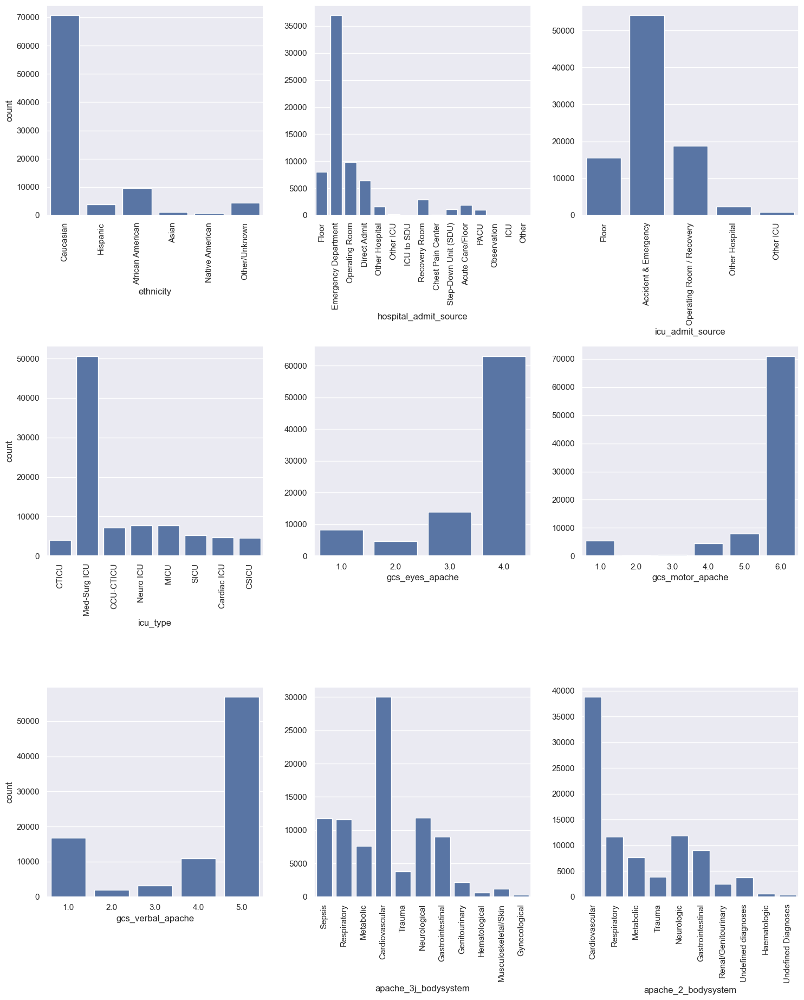

In [27]:
# Columns with 4 to 15 distinct values
cols_selected = [col for col in data.columns if 3 < data[col].nunique() <= 15]
col_vert = ['ethnicity', 'hospital_admit_source', 'icu_admit_source', 'icu_type', 'apache_3j_bodysystem', 'apache_2_bodysystem']
nrows = math.ceil(len(cols_selected)/3)
fig, ax = plt.subplots(nrows, 3, figsize = (15, 6.2 * nrows), sharey = False)
for i in range(len(cols_selected)):
    countplot = sns.countplot(data = data, x = cols_selected[i], ax = ax[i//3, i%3])
    if cols_selected[i] in col_vert:
        countplot.set_xticklabels(countplot.get_xticklabels(), rotation = 90)
    if i%3 != 0:
        ax[i//3, i%3].set_ylabel(" ")
plt.tight_layout()
plt.show()

In [28]:
# Non-float columns with more than 15 distinct values
[col for col in data.columns if data[col].nunique() > 15 and data[col].dtype != 'float64']

['encounter_id', 'patient_id', 'hospital_id', 'icu_id']

In [29]:
# Number of unique values
keys = ['encounter_id', 'patient_id', 'hospital_id', 'icu_id']
values = [data[col].nunique() for col in keys]
print(pd.Series(data = values, index = keys).to_string())

encounter_id    91713
patient_id      91713
hospital_id       147
icu_id            241


**Observation:** The features `encounter_id` and `patient_id` are unique for each observation, and hence do not contribute to the task of predicting the target variable.

In [30]:
# Dropping encounter_id and patient_id
data.drop(['encounter_id', 'patient_id'], axis = 1, inplace = True)
cols_int.remove('encounter_id')
cols_int.remove('patient_id')

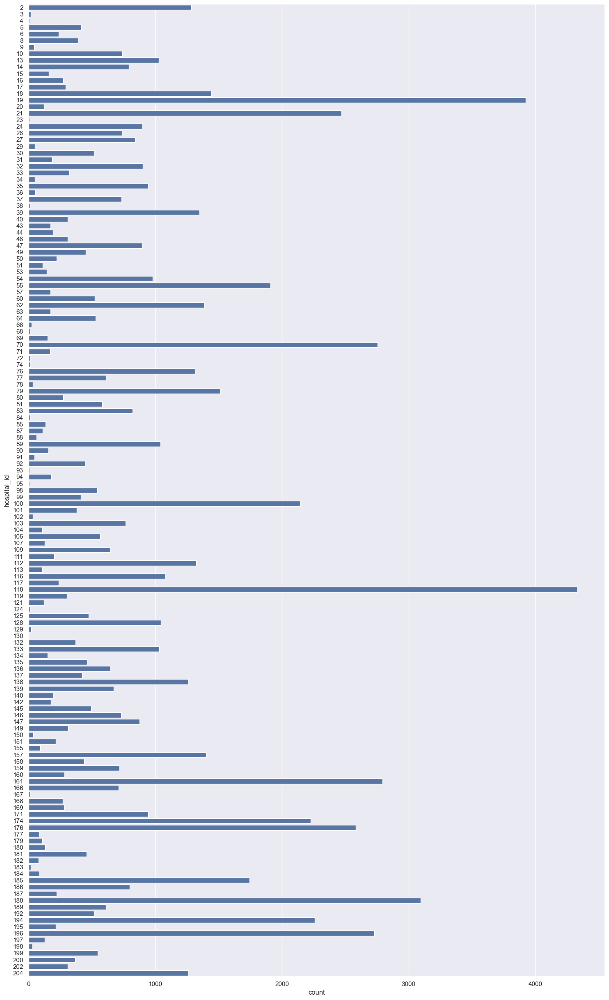

In [31]:
# hospital_id
plt.figure(figsize = (15, data['hospital_id'].nunique()/6))
sns.countplot(data = data, y = 'hospital_id')
plt.tight_layout()
plt.show()

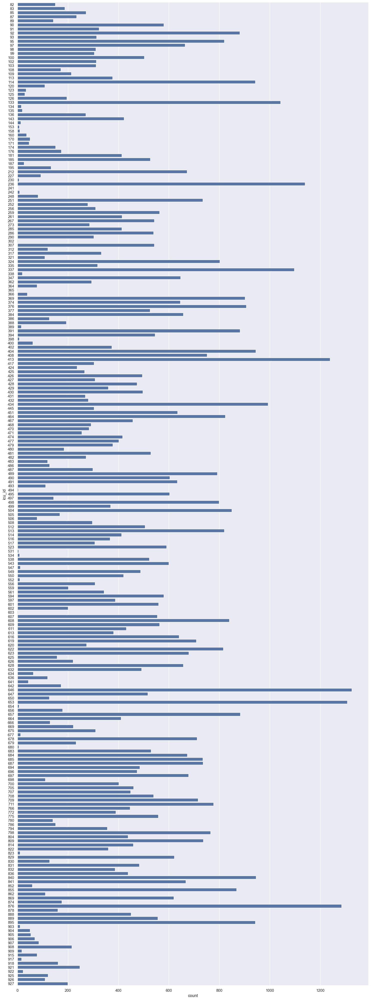

In [32]:
# icu_id
plt.figure(figsize = (15, data['icu_id'].nunique()/6))
sns.countplot(data = data, y = 'icu_id')
plt.tight_layout()
plt.show()

In [33]:
# Histograms in grid
def distribution_plot(df, cols, ncols = 4, kind = 'hist', hue = None, height = 0.84*4, width = 4):
    cols = [col for col in df.columns if df[col].nunique() > 15 and df[col].dtype == 'float64']
    bins_fd = math.floor(len(df)**(1/3))
    nrows = math.ceil(len(cols)/ncols)
    if kind == 'hist':
        fig, ax = plt.subplots(nrows, ncols, figsize = (width*ncols, height*nrows), sharey = False)
        for i in range(len(cols)):
            sns.histplot(data = df, x = cols[i], bins = bins_fd, hue = hue, ax = ax[i // ncols, i % ncols])
            if i % ncols != 0:
                ax[i // ncols, i % ncols].set_ylabel(" ")
    elif kind == 'kde':
        fig, ax = plt.subplots(nrows, ncols, figsize = (width*ncols, height*nrows), sharey = False)
        for i in range(len(cols)):
            sns.kdeplot(data = df, x = cols[i], hue = hue, ax = ax[i // ncols, i % ncols])
            if i % ncols != 0:
                ax[i // ncols, i % ncols].set_ylabel(" ")
    else:
        raise TypeError(f"'{kind}' is not a valid argument for the parameter kind. Use 'hist' or 'kde'.")
    plt.tight_layout()
    plt.show()

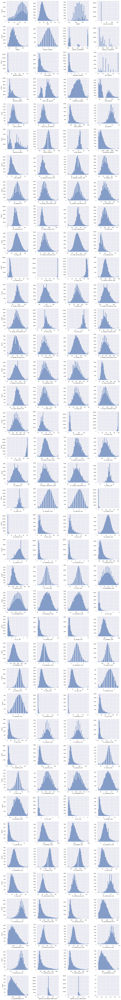

In [34]:
# Float columns with more than 15 distinct values
cols_selected = [col for col in data.columns if data[col].nunique() > 15 and data[col].dtype == 'float64']
distribution_plot(df = data, cols = cols_selected, kind = 'hist')

<a name = "Multivariate-Analysis"></a>
## 2.4. Multivariate Analysis

- Relationships among the predictor variables
- Relationships of the target variable with the predictor variables

<a name = "Relationships-among-the-predictor-variables"></a>
### 2.4.1. Relationships among the predictor variables

### Correlation structure among numerical features

In [35]:
# Heatmap
cols_selected = [col for col in cols_int + cols_float if col != 'hospital_death']
plt.figure(figsize = (180, 135))
sns.heatmap(data[cols_selected].corr(), annot = True, cmap = plt.cm.CMRmap_r)

<Axes: >

In [36]:
# Function to detect pairs with extreme correlation
def pairs_with_strong_corr(df, cols, threshold = 0.8, show = True, return_variables = False):
    variable_list = []
    corr_positive_list = []
    corr_negative_list = []
    for i in range(len(cols)):
        for j in range(len(cols)):
            if i<j:
                corr = df[cols[i]].corr(df[cols[j]])
                if corr > threshold:
                    variable_list = variable_list + [cols[i], cols[j]]
                    corr_positive_list.append(((cols[i], cols[j]), corr))
                if corr < -threshold:
                    variable_list = variable_list + [cols[i], cols[j]]
                    corr_negative_list.append(((cols[i], cols[j]), corr))
    if show == True:
        corr_positive = pd.Series(data = [item[1] for item in corr_positive_list], index = [item[0] for item in corr_positive_list])
        corr_negative = pd.Series(data = [item[1] for item in corr_negative_list], index = [item[0] for item in corr_negative_list])
        print("Pairs with extreme positive correlation:")
        print(" ")
        print(corr_positive.sort_values(ascending = False).to_string())
        print(" ")
        print("Pairs with extreme negative correlation:")
        print(" ")
        print(corr_negative.sort_values(ascending = True).to_string())
    if return_variables == True:
        return variable_list

In [37]:
# Detecting pairs with extreme correlation
cols_selected = [col for col in cols_int + cols_float if col != 'hospital_death']
pairs_with_strong_corr(df = data, cols = cols_selected, threshold = 0.9)

Pairs with extreme positive correlation:
 
(d1_inr_max, h1_inr_max)                        1.000000
(paco2_apache, paco2_for_ph_apache)             1.000000
(d1_inr_min, h1_inr_min)                        1.000000
(h1_bilirubin_max, h1_bilirubin_min)            0.999934
(h1_albumin_max, h1_albumin_min)                0.999727
(h1_bun_max, h1_bun_min)                        0.999630
(h1_creatinine_max, h1_creatinine_min)          0.999405
(h1_platelets_max, h1_platelets_min)            0.998206
(d1_diasbp_max, d1_diasbp_noninvasive_max)      0.997831
(h1_wbc_max, h1_wbc_min)                        0.997524
(d1_diasbp_min, d1_diasbp_noninvasive_min)      0.996871
(h1_mbp_min, h1_mbp_noninvasive_min)            0.996673
(bilirubin_apache, d1_bilirubin_max)            0.996568
(d1_sysbp_max, d1_sysbp_noninvasive_max)        0.996560
(h1_sysbp_max, h1_sysbp_noninvasive_max)        0.996377
(d1_sysbp_min, d1_sysbp_noninvasive_min)        0.996322
(d1_mbp_min, d1_mbp_noninvasive_min)         

**Observations:**

- There are $94$ pairs of numerical features with correlation coefficient over $0.9$
- There are no pair of numerical features with correlation coefficient below $-0.9$
- $3$ pairs of numerical features have correlation coefficient exactly equal to $1,$ i.e. there exists perfect linear relationship (with positive slope) between the variables in each of those pairs (this corresponds to the fact that there are $3$ duplicate columns in the dataset)

<a name = "Relationships-of-the-target-variable-with-the-predictor-variables"></a>
### 2.4.2. Relationships of the target variable with the predictor variables

In [38]:
# Contingency tables for target variable and binary features
def contingency_binary(df, target, ncols = 3, figsize_multiplier = 2):
    cols_binary = [col for col in df.columns if df[col].nunique() == 2]
    cols_binary.remove(target)
    if len(cols_binary) == 0:
        print("The dataset does not contain a binary feature")
    else:
        nrows = math.ceil(len(cols_binary)/ncols)
        nvals = 2 # Binary variables
        figsize = (figsize_multiplier*nvals*ncols, 0.8*figsize_multiplier*nvals*nrows)
        fig, ax = plt.subplots(nrows, ncols, figsize = figsize, sharey = False)
        class_names_2 = df[target].value_counts().index.tolist()
        for i in range(len(cols_binary)):
            class_names_1 = df[cols_binary[i]].value_counts().index.tolist()
            contingency_mat = np.zeros(shape = (len(class_names_2), len(class_names_1)))
            for j in range(len(class_names_2)):
                for k in range(len(class_names_1)):
                    contingency_mat[j][k] = len([l for l in range(len(df)) if df[target][l] == class_names_2[j] and df[cols_binary[i]][l] == class_names_1[k]])
            contingency_table_df = pd.DataFrame(contingency_mat)
            hm = sns.heatmap(contingency_table_df, annot = True, annot_kws = {"size": 16}, fmt = 'g', ax = ax[i // ncols, i % ncols])
            hm.set_xlabel(f'{cols_binary[i]}', fontsize = 14)
            hm.set_ylabel(target, fontsize = 14)
            hm.set_xticklabels(class_names_1, fontdict = {'fontsize': 12}, rotation = 0, ha = "right")
            hm.set_yticklabels(class_names_2, fontdict = {'fontsize': 12}, rotation = 0, ha = "right")
            if i % ncols != 0:
                ax[i // ncols, i % ncols].set_ylabel(" ")
        plt.tight_layout()
        plt.show()

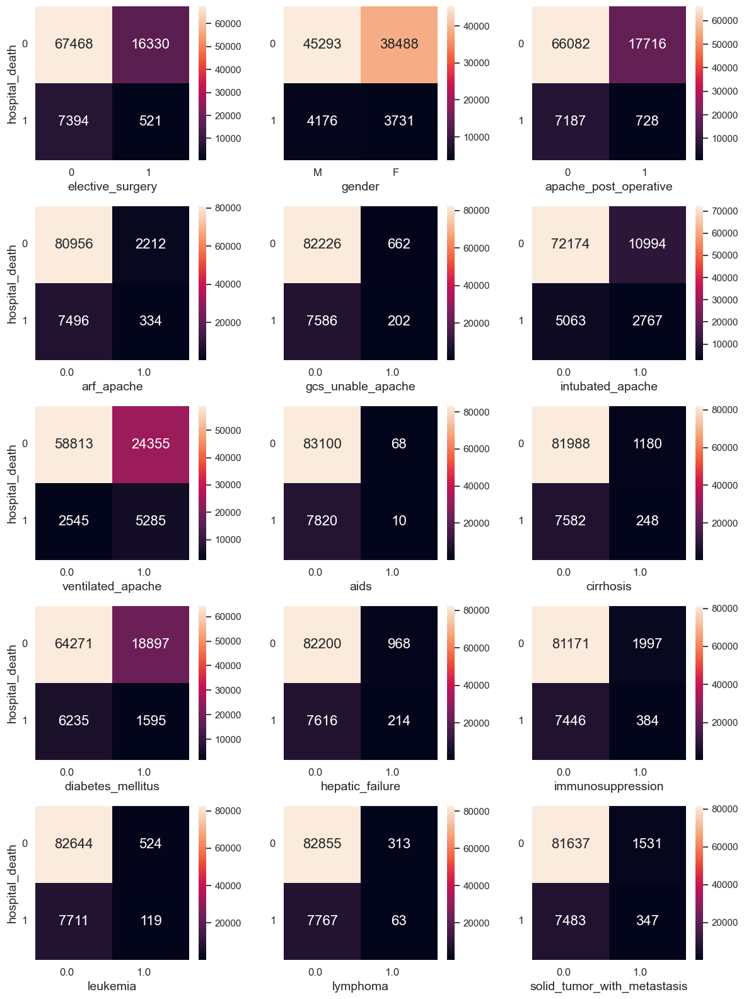

In [39]:
# Target x Binary features
contingency_binary(df = data, target = 'hospital_death', ncols = 3, figsize_multiplier = 2)

In [40]:
# Contingency table for target variable and general categorical feature
def contingency_table(df, feature, target, figsize_multiplier = 2, title = False, rotate_xticklabels = 0, rotate_yticklabels = 0):
    class_names_1 = df[feature].value_counts().index.tolist()
    class_names_2 = df[target].value_counts().index.tolist()

    contingency_mat = np.zeros(shape = (len(class_names_2), len(class_names_1)))
    for i in range(len(class_names_2)):
        for j in range(len(class_names_1)):
            contingency_mat[i][j] = len([k for k in range(len(df)) if df[target][k] == class_names_2[i] and df[feature][k] == class_names_1[j]])

    contingency_table_df = pd.DataFrame(contingency_mat)
    plt.figure(figsize = (figsize_multiplier*len(class_names_1), 0.8*figsize_multiplier*len(class_names_2)))
    if title == True:
        plt.title(f"{target} x {feature}")
    hm = sns.heatmap(contingency_table_df, annot = True, annot_kws = {"size": 16}, fmt = 'g')
    hm.set_xlabel(f'{feature}', fontsize = 14)
    hm.set_ylabel(f'{target}', fontsize = 14)
    hm.set_xticklabels(class_names_1, fontdict = {'fontsize': 12}, rotation = rotate_xticklabels, ha = "right")
    hm.set_yticklabels(class_names_2, fontdict = {'fontsize': 12}, rotation = rotate_yticklabels, ha = "right")
    plt.grid(False)
    plt.show()

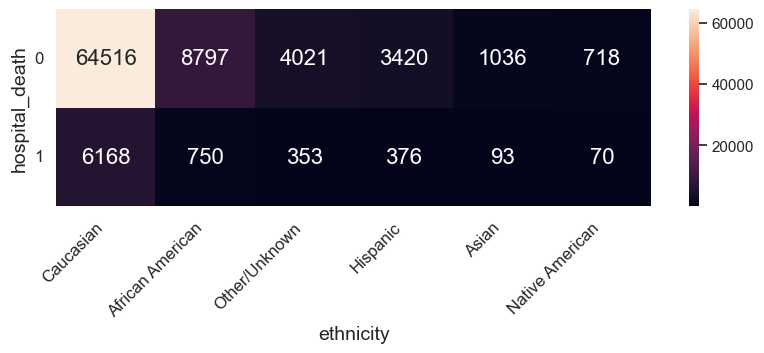

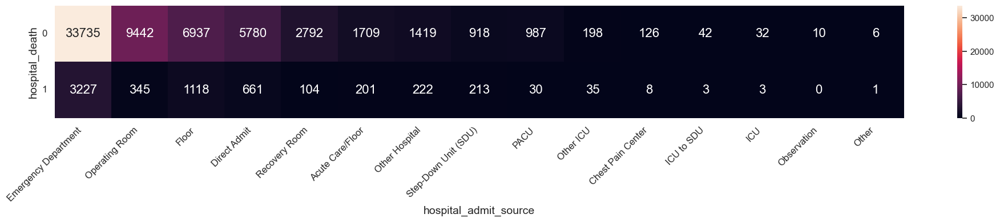

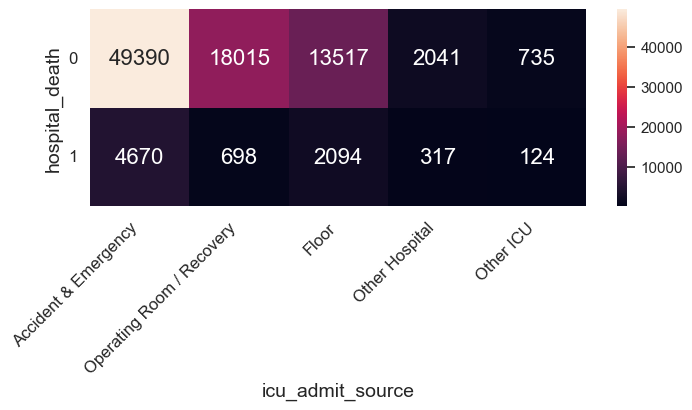

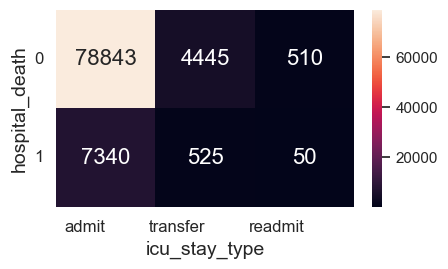

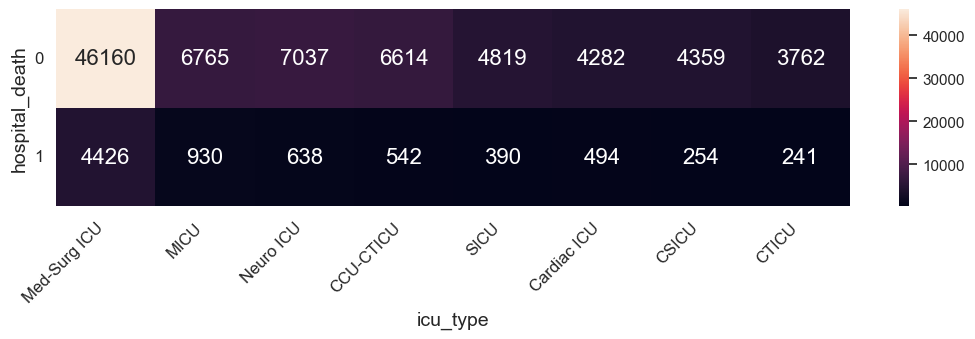

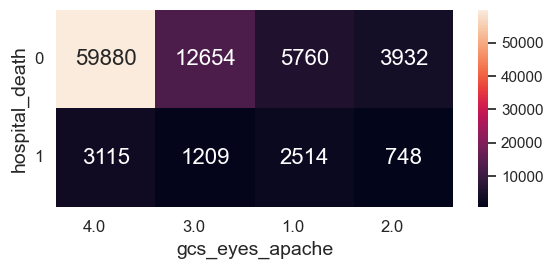

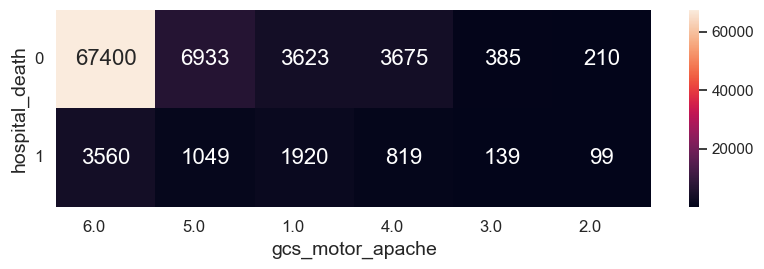

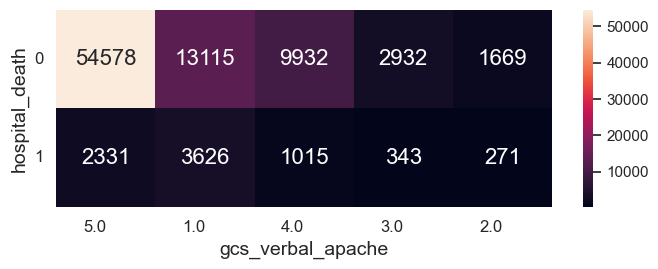

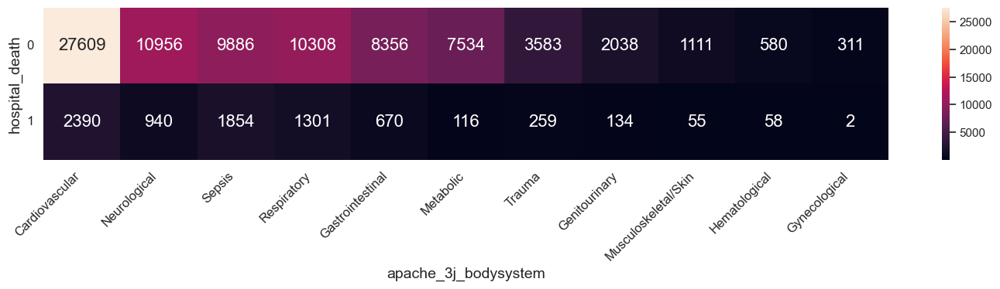

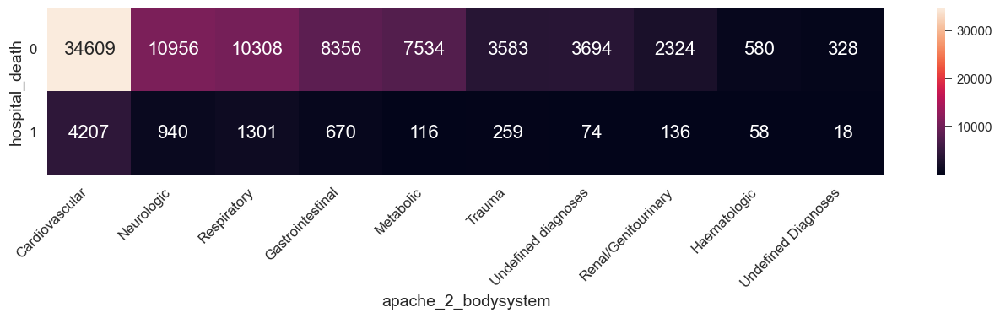

In [41]:
# Target x Features taking 3 to 15 distinct values
cols_selected = [col for col in data.columns if 3 <= data[col].nunique() <= 15]
cols_xticklabels = ['ethnicity', 'hospital_admit_source', 'icu_admit_source', 'icu_type', 'apache_3j_bodysystem', 'apache_2_bodysystem']
for col in cols_selected:
    if col in cols_xticklabels:
        rotate_xticklabels = 45
    else:
        rotate_xticklabels = 0
    contingency_table(df = data, feature = col, target = 'hospital_death', figsize_multiplier = 1.6, rotate_xticklabels = rotate_xticklabels)

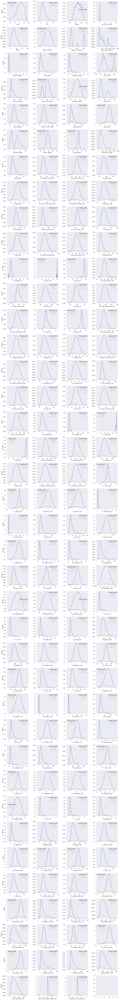

In [42]:
# Target x Float features with more than 15 distinct values
cols_selected = [col for col in data.columns if data[col].nunique() > 15 and data[col].dtype == 'float64']
distribution_plot(df = data, cols = cols_selected, kind = 'kde', hue = 'hospital_death')

<a name = "Data-Preprocessing"></a>
# 3. Data Preprocessing

- Train-Test Split
- Missing Data Imputation
- Categorical Data Encoding
- Normalization

<a name = "Train-Test-Split"></a>
## 3.1. Train-Test Split

In [43]:
X = data.drop('hospital_death', axis = 1) # Independent variables
y = data['hospital_death'] # Target variable
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True)

### Training data

In [44]:
# Training set - Predictor variables
X_train

,hospital_id,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,...,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
60824,187,83.0,18.893006,0,Caucasian,F,167.6,Emergency Department,Accident & Emergency,626,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
2211,77,80.0,38.768576,0,Caucasian,M,167.6,NaN,Accident & Emergency,87,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic
48717,189,86.0,27.236914,0,Caucasian,F,170.2,Emergency Department,Accident & Emergency,543,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Genitourinary,Renal/Genitourinary
43043,100,82.0,27.587326,0,Caucasian,F,157.0,Emergency Department,Accident & Emergency,491,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
21975,147,79.0,22.534014,0,Caucasian,F,168.0,Emergency Department,Accident & Emergency,317,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Gastrointestinal,Gastrointestinal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72861,13,61.0,41.020378,0,Caucasian,M,185.4,NaN,Accident & Emergency,708,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
72244,64,82.0,19.850251,0,African American,M,175.3,NaN,Accident & Emergency,683,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
6657,118,59.0,23.731608,0,Caucasian,F,171.5,Direct Admit,Accident & Emergency,89,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic
35517,70,NaN,NaN,0,Caucasian,M,179.0,Emergency Department,Accident & Emergency,464,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [45]:
# Training set - Target variable
bar_donut(pd.DataFrame(y_train), 'hospital_death',  manual_title_text = True,
          title_text = "Frequency distribution of hospital_death in the training set")

### Test data

In [46]:
# Test set - Predictor variables
X_test

,hospital_id,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,...,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
1925,118,75.0,33.822121,0,Hispanic,F,157.5,Emergency Department,Accident & Emergency,100,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Trauma,Trauma
40421,54,66.0,64.824982,1,Other/Unknown,F,165.1,NaN,Operating Room / Recovery,474,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Respiratory,Respiratory
90989,66,34.0,27.472944,0,Caucasian,M,190.5,Emergency Department,Accident & Emergency,922,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
55949,194,54.0,24.017770,1,Asian,F,147.0,Direct Admit,Accident & Emergency,594,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic
70021,185,43.0,25.632116,0,Other/Unknown,F,167.6,NaN,Accident & Emergency,679,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Neurological,Neurologic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44320,53,67.0,26.185200,0,Caucasian,M,179.0,Emergency Department,Accident & Emergency,497,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
27984,112,63.0,38.200184,0,Caucasian,F,165.0,NaN,Accident & Emergency,347,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Respiratory,Respiratory
88801,188,59.0,28.130489,0,Caucasian,M,172.7,Emergency Department,Accident & Emergency,855,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular
5062,118,61.0,27.637843,0,NaN,M,185.4,Emergency Department,Accident & Emergency,97,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Cardiovascular,Cardiovascular


In [47]:
# Test set - Target variable
bar_donut(pd.DataFrame(y_test), 'hospital_death', manual_title_text = True,
          title_text = "Frequency distribution of hospital_death in the test set")

<a name = "Missing-Data-Imputation"></a>
## 3.2. Missing Data Imputation

In [48]:
# Count of missing values for the target variable
print(pd.Series({"Number of missing target values in the training set": y_train.isna().sum(),
                 "Number of missing target values in the test set": y_test.isna().sum()}).to_string())

Number of missing target values in the training set    0
Number of missing target values in the test set        0


### Dropping columns with majority of the observations missing

In [49]:
# Columns with more than 50% missing values in the training set
print((X_train.isna().sum()/len(X_train))[X_train.isna().sum()/len(X_train) > 0.5].sort_values(ascending = False))

h1_bilirubin_max      0.922543
h1_bilirubin_min      0.922543
h1_lactate_min        0.919817
h1_lactate_max        0.919817
h1_albumin_max        0.913889
                        ...   
h1_glucose_max        0.572387
h1_glucose_min        0.572387
d1_albumin_min        0.534973
d1_albumin_max        0.534973
urineoutput_apache    0.534374
Length: 74, dtype: float64


We drop the $74$ features, which have over $50\%$ values missing in the training dataset, from the subsequent analysis.

In [50]:
# Dropping columns with more than 50% missing values in the training set
majority_missing = (X_train.isna().sum()/len(X_train))[data.isna().sum()/len(data) > 0.5].index.tolist()
X_train.drop(majority_missing, axis = 1, inplace = True)
X_test.drop(majority_missing, axis = 1, inplace = True)

### Mode imputation

In [51]:
# Function to impute missing values with the most frequent value appearing in the corresponding columns
def mode_imputer(data):
    data_imputed = data.copy(deep = True)
    imputer = SimpleImputer(strategy = 'most_frequent')
    data_imputed.iloc[:, :] = imputer.fit_transform(data_imputed)
    return data_imputed

### Proportion-based imputation

With the goal of keeping the feature distributions same before and after imputation, we impute the missing values in a column in such a way so that the proportions of the existing unique values in that particular column remain roughly same as those were prior to the imputation. The following function takes a dataframe, implements the proportion-based imputation in each column containing missing values and returns the resulting dataframe.

In [52]:
# Function to impute missing values proportionately with respect to the existing unique values
def prop_imputer(df):
    df_prop = df.copy(deep = True)
    missing_cols = df_prop.isna().sum()[df_prop.isna().sum() != 0].index.tolist()
    for col in missing_cols:
        values_col = df_prop[col].value_counts(normalize = True).index.tolist()
        probabilities_col = df_prop[col].value_counts(normalize = True).values.tolist()
        df_prop[col] = df_prop[col].fillna(pd.Series(data = np.random.choice(values_col, p = probabilities_col, size = len(df_prop)), index = df_prop[col].index))
    return df_prop

In [53]:
# Proportion-based imputation
X_train = prop_imputer(X_train)
X_test = prop_imputer(X_test)

<a name = "Categorical-Data-Encoding"></a>
## 3.3. Categorical Data Encoding

In [54]:
# Object type columns and corresponding number of unique values
print(pd.Series(data = [data[col].nunique() for col in cols_object], index = cols_object).to_string())

ethnicity                 6
gender                    2
hospital_admit_source    15
icu_admit_source          5
icu_stay_type             3
icu_type                  8
apache_3j_bodysystem     11
apache_2_bodysystem      10


All $8$ categorical features are nominal in nature, i.e. there is no notion of order in their realized values.

### Label encoding

In [55]:
def label_encoder(df, cols):
    df_le = df.copy(deep = True)
    le = LabelEncoder()
    for col in cols:
        df_le[col] = le.fit_transform(df_le[col])
    return df_le

Explanation of the arguments:
- **df:** The input dataset
- **cols:** List of columns that we want to encode

In [56]:
X_train_le = label_encoder(X_train, cols_object)
X_test_le = label_encoder(X_test, cols_object)

For a categorical column with $n$ distinct values, the label encoder maps the $n$ distinct values to numerical values between $0$ and $n-1$.

In [57]:
# Example
X_train_le[[col for col in X_train_le.columns if cols_object[1] in col]]

,gender
60824,0
2211,1
48717,0
43043,0
21975,0
...,...
72861,1
72244,1
6657,0
35517,1


### One-hot encoding

In [58]:
# Function for one-hot encoding
def one_hot_encoder(df, cols, drop_first = False):
    cols = [col for col in cols if col in df.columns] # To ensure that 'cols' is contained (as a subset) within df.columns
    df_ohe = pd.get_dummies(df, columns = cols, drop_first = drop_first)
    return df_ohe

Explanation of the arguments:
- **df:** The input dataset
- **cols:** List of columns that we want to encode

In [59]:
# One-hot encoding with drop_first = False
X_concat = pd.concat([X_train, X_test])
X_concat_ohe = one_hot_encoder(X_concat, cols_object, drop_first = False)
X_train_ohe = X_concat_ohe.loc[X_train.index]
X_test_ohe = X_concat_ohe.loc[X_test.index]

For a categorical column with $k$ distinct values, the [one-hot](https://en.wikipedia.org/wiki/One-hot) encoder produces $k$ new columns, one corresponding to each unique value. The original column is then dropped.

In [60]:
# Example
X_train_ohe[[col for col in X_train_ohe.columns if cols_object[1] in col]]

,gender_F,gender_M
60824,True,False
2211,False,True
48717,True,False
43043,True,False
21975,True,False
...,...,...
72861,False,True
72244,False,True
6657,True,False
35517,False,True


Note that `gender_F` and `gender_M` are related by `gender_F + gender_M = 1`. Hence we shall lose no information by dropping one of these columns. This can be done (for each feature) by changing `drop_first = False` to `drop_first = True`.

In [61]:
# One-hot encoding with drop_first = True
X_concat_ohe = one_hot_encoder(X_concat, cols_object, drop_first = True)
X_train_ohe = X_concat_ohe.loc[X_train.index]
X_test_ohe = X_concat_ohe.loc[X_test.index]

Now the one-hot encoder produces $k-1$ new columns for a categorical column with $k$ distinct values, by dropping the first column. As before, the original column is also dropped.

In [62]:
# Example
X_train_ohe[[col for col in X_train_ohe.columns if cols_object[1] in col]]

,gender_M
60824,False
2211,True
48717,False
43043,False
21975,False
...,...
72861,True
72244,True
6657,False
35517,True


To have a column corresponding to `nan` values (if they are present in the original column), one must set the `dummy_na` parameter of the `get_dummies` function to be `True` (which is by default `False`).

In [63]:
# Replacing original predictors with encoded predictors
X_train = X_train_ohe
X_test = X_test_ohe

<a name = "Normalization"></a>
## 3.4. Normalization

In [64]:
# Min-max normalization of predictors in the training set
for col in X_train.columns:
    if X_train[col].dtypes == 'int64' or X_train[col].dtypes == 'float64': # Checking if the column is numerical
        if X_train[col].nunique() > 1: # Checking if the column is non-constant
            X_train[col] = (X_train[col] - X_train[col].min()) / (X_train[col].max() - X_train[col].min())
X_train

,hospital_id,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,weight,apache_2_diagnosis,apache_3j_diagnosis,...,apache_3j_bodysystem_Trauma,apache_2_bodysystem_Gastrointestinal,apache_2_bodysystem_Haematologic,apache_2_bodysystem_Metabolic,apache_2_bodysystem_Neurologic,apache_2_bodysystem_Renal/Genitourinary,apache_2_bodysystem_Respiratory,apache_2_bodysystem_Trauma,apache_2_bodysystem_Undefined Diagnoses,apache_2_bodysystem_Undefined diagnoses
60824,0.915842,0.917808,0.076422,0.0,0.520637,0.643787,0.080445,0.098168,0.057971,0.227638,...,False,False,False,False,False,False,False,False,False,False
2211,0.371287,0.876712,0.451645,0.0,0.520637,0.005917,0.079714,0.476934,0.096618,0.185826,...,False,False,False,False,True,False,False,False,False,False
48717,0.925743,0.958904,0.233943,0.0,0.565165,0.545562,0.080594,0.273406,0.985507,0.409352,...,False,False,False,False,False,True,False,False,False,False
43043,0.485149,0.904110,0.240559,0.0,0.339099,0.484024,0.080264,0.199457,0.077295,0.048159,...,False,False,False,False,False,False,False,False,False,False
21975,0.717822,0.863014,0.145159,0.0,0.527488,0.278107,0.080036,0.169607,0.980676,0.139480,...,False,True,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72861,0.054455,0.616438,0.494156,0.0,0.825484,0.740828,0.080787,0.694708,0.057971,0.227638,...,False,False,False,False,False,False,False,False,False,False
72244,0.306931,0.904110,0.094493,0.0,0.652509,0.711243,0.081393,0.151967,0.043478,0.047250,...,False,False,False,False,False,False,False,False,False,False
6657,0.574257,0.589041,0.167768,0.0,0.587429,0.008284,0.079819,0.211669,0.966184,0.184004,...,False,False,False,False,True,False,False,False,False,False
35517,0.336634,0.164384,0.261963,0.0,0.715876,0.452071,0.072451,0.483718,0.111111,0.273053,...,False,False,False,False,False,False,True,False,False,False


In [65]:
# Min-max normalization of predictors in the test set
for col in X_test.columns:
    if X_test[col].dtypes == 'int64' or X_test[col].dtypes == 'float64': # Checking if the column is numerical
        if X_test[col].nunique() > 1: # Checking if the column is non-constant
           X_test[col] = (X_test[col] - X_test[col].min()) / (X_test[col].max() - X_test[col].min())
X_test

,hospital_id,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,weight,apache_2_diagnosis,apache_3j_diagnosis,...,apache_3j_bodysystem_Trauma,apache_2_bodysystem_Gastrointestinal,apache_2_bodysystem_Haematologic,apache_2_bodysystem_Metabolic,apache_2_bodysystem_Neurologic,apache_2_bodysystem_Renal/Genitourinary,apache_2_bodysystem_Respiratory,apache_2_bodysystem_Trauma,apache_2_bodysystem_Undefined Diagnoses,apache_2_bodysystem_Undefined diagnoses
1925,0.574257,0.808219,0.358263,0.0,0.347662,0.021302,0.240622,0.307327,0.086957,0.273043,...,True,False,False,False,False,False,False,True,False,False
40421,0.257426,0.684932,0.943553,1.0,0.477822,0.463905,0.243548,0.936906,0.975845,0.592460,...,False,False,False,False,False,False,True,False,False,False
90989,0.316832,0.246575,0.238399,0.0,0.912828,0.994083,0.240903,0.414518,0.077295,0.048146,...,False,False,False,False,False,False,False,False,False,False
55949,0.950495,0.520548,0.173170,1.0,0.167837,0.605917,0.243856,0.090231,0.966184,0.684245,...,False,False,False,False,True,False,False,False,False,False
70021,0.905941,0.369863,0.203647,0.0,0.520637,0.706509,0.241533,0.226594,0.966184,0.185360,...,False,False,False,False,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44320,0.252475,0.698630,0.214088,0.0,0.715876,0.491124,0.241580,0.307327,0.057971,0.227627,...,False,False,False,False,False,False,False,False,False,False
27984,0.544554,0.643836,0.440914,0.0,0.476109,0.313609,0.240970,0.443691,0.019324,0.094034,...,False,False,False,False,False,False,True,False,False,False
88801,0.920792,0.589041,0.250813,0.0,0.607981,0.914793,0.240575,0.307327,0.971014,0.049514,...,False,False,False,False,False,False,False,False,False,False
5062,0.574257,0.616438,0.241512,0.0,0.825484,0.017751,0.240555,0.382632,0.062802,0.046329,...,False,False,False,False,False,False,False,False,False,False


<a name = "Baseline-Neural-Network"></a>
# Model 1: Multilayer Perceptron (MLP)

In [142]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam

# Improved Model Architecture
model = Sequential()

# Input layer and first hidden layer
model.add(Dense(64, input_dim=len(X_train.columns), activation='relu', kernel_regularizer=l2(0.001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))  # Increased dropout rate for stronger regularization

# Second hidden layer
model.add(Dense(32, activation='relu', kernel_regularizer=l2(0.001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))

# Third hidden layer
model.add(Dense(16, activation='relu', kernel_regularizer=l2(0.001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))

# Output layer
model.add(Dense(1, activation='sigmoid'))

# Compile the model
optimizer = Adam(learning_rate=0.001)  # Optimizer with learning rate scheduling option
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_21 (Dense)                │ (None, 64)             │         9,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 32)             │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16)             │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_15 (Dropout)            │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 12,865 (50.25 KB)

 Trainable params: 12,641 (49.38 KB)

 Non-trainable params: 224 (896.00 B)

In [145]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

# Ensure y_train is in the correct format
y_train = np.array(y_train)

# Determine the unique classes in y_train
classes = np.unique(y_train)

# Compute class weights automatically
class_weights = compute_class_weight('balanced', classes=classes, y=y_train)
class_weight_dict = dict(zip(classes, class_weights))

print(f"Class weights: {class_weight_dict}")

# Fit the model with the computed class weights
model.fit(X_train, y_train, epochs=50, batch_size=32, class_weight=class_weight_dict)


Class weights: {0: 0.5470311055441234, 1: 5.81563094483196}
Epoch 1/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.6004 - loss: 0.8123
Epoch 2/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7416 - loss: 0.5909
Epoch 3/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7475 - loss: 0.5399
Epoch 4/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7628 - loss: 0.5081
Epoch 5/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7649 - loss: 0.4973
Epoch 6/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7591 - loss: 0.4969
Epoch 7/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7672 - loss: 0.4885
Epoch 8/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7652 - loss: 0.4937
Epoch 9/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7578 - loss: 0.4933
Epoch 10/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7636 - loss: 0.4921
Epoch 11/50
2293/2293 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - ac

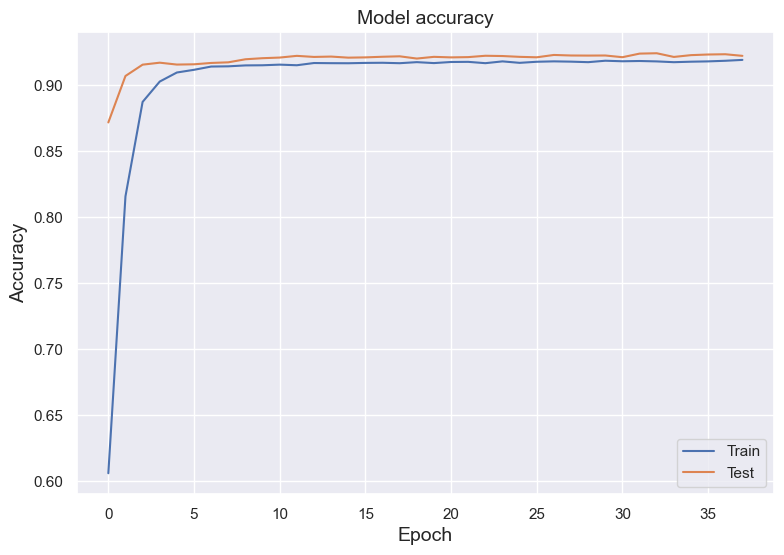

In [146]:
# Visualization of model accuracy
model_accuracy = pd.DataFrame()
model_accuracy['accuracy'] = history.history['accuracy']
model_accuracy['val_accuracy'] = history.history['val_accuracy']

plt.figure(figsize = (9, 6))
sns.lineplot(data = model_accuracy['accuracy'], label = 'Train')
sns.lineplot(data = model_accuracy['val_accuracy'], label = 'Test')
plt.title('Model accuracy', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend()
plt.show()

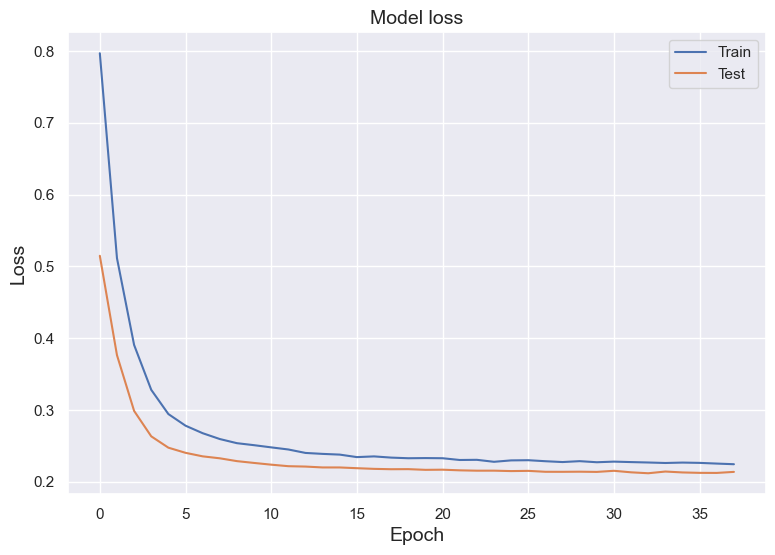

In [147]:
# Visualization of model loss
model_loss = pd.DataFrame()
model_loss['loss'] = history.history['loss']
model_loss['val_loss'] = history.history['val_loss']

plt.figure(figsize = (9, 6))
sns.lineplot(data = model_loss['loss'], label = 'Train')
sns.lineplot(data = model_loss['val_loss'], label = 'Test')
plt.title('Model loss', fontsize = 14)
plt.ylabel('Loss', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend()
plt.show()

In [148]:
# Prediction on test set
pred = model.predict(X_test)
threshold = 0.5
y_pred = [0 if pred[i][0] < threshold else 1 for i in range(len(pred))]

574/574 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


In [149]:
# Function to compute and visualize confusion matrix
def confusion_mat(y_pred, y_test):
    class_names = [0, 1]
    tick_marks_y = [0.5, 1.5]
    tick_marks_x = [0.5, 1.5]
    confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
    confusion_matrix_df = pd.DataFrame(confusion_matrix, range(2), range(2))
    plt.figure(figsize = (6, 4.75))
    plt.title("Confusion Matrix", fontsize = 14)
    hm = sns.heatmap(confusion_matrix_df, annot = True, annot_kws = {"size": 16}, fmt = 'd') # font size
    hm.set_xlabel("Predicted label", fontsize = 14)
    hm.set_ylabel("True label", fontsize = 14)
    hm.set_xticklabels(class_names, fontdict = {'fontsize': 14}, rotation = 0, ha = "right")
    hm.set_yticklabels(class_names, fontdict = {'fontsize': 14}, rotation = 0, ha = "right")
    plt.grid(False)
    plt.show()

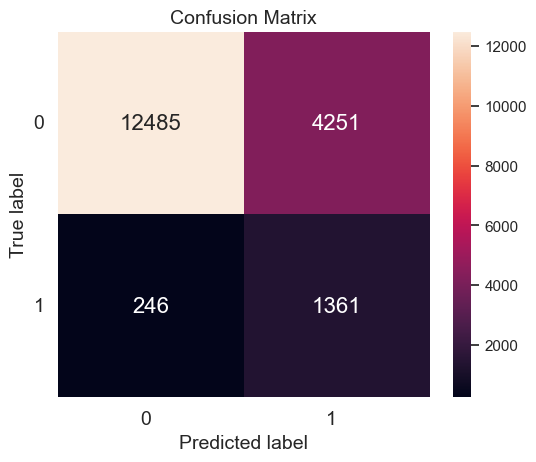

In [150]:
# Confusion matrix
confusion_mat(y_pred, y_test)

In [151]:
from sklearn.metrics import matthews_corrcoef

# Evaluation metrics
acc = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
mcc = matthews_corrcoef(y_test, y_pred)

# Printing the metrics
print(pd.Series({"Accuracy": acc,
                 "ROC-AUC": roc_auc,
                 "Precision": precision,
                 "Recall": recall,
                 "F1-score": f1,
                 "MCC": mcc}).to_string())


Accuracy     0.754838
ROC-AUC      0.796458
Precision    0.242516
Recall       0.846920
F1-score     0.377061
MCC          0.363779


<a name = "Hyperparameter-Tuning"></a>
# 5. Hyperparameter Tuning

In [152]:
import kerastuner as kt
from tensorflow.keras.optimizers import Adam

def build_model(hp):
    model = Sequential()
    
    # Input layer and first hidden layer with variable units
    model.add(Dense(units=hp.Int('units_1', min_value=32, max_value=128, step=32), 
                    input_dim=len(X_train.columns), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_1', min_value=0.001, max_value=0.01, step=0.001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_1', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Second hidden layer with variable units
    model.add(Dense(units=hp.Int('units_2', min_value=16, max_value=64, step=16), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_2', min_value=0.001, max_value=0.01, step=0.001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_2', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Third hidden layer with variable units
    model.add(Dense(units=hp.Int('units_3', min_value=8, max_value=32, step=8), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_3', min_value=0.001, max_value=0.01, step=0.001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_3', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Output layer
    model.add(Dense(1, activation='sigmoid'))
    
    # Compile the model
    model.compile(optimizer=Adam(learning_rate=hp.Float('lr', min_value=1e-4, max_value=1e-2, sampling='LOG')),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    
    return model


In [157]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,  # Number of different hyperparameter combinations to try
    executions_per_trial=1,  # Number of models to train for each hyperparameter set
    project_name='hyperparameter_tuning')


In [159]:
# If you want to split data for validation within the tuner, specify it here:
tuner.search(X_train, y_train, epochs=20, batch_size=32, validation_split=0.2, class_weight=class_weight_dict)

Trial 5 Complete [00h 01m 39s]
val_accuracy: 0.828812837600708

Best val_accuracy So Far: 0.8969606161117554
Total elapsed time: 00h 08m 45s


In [160]:
# Retrieve the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print the best hyperparameters
print(f"""
The optimal number of units in the first layer is {best_hps.get('units_1')},
the optimal L2 regularization for the first layer is {best_hps.get('l2_1')},
the optimal dropout rate for the first layer is {best_hps.get('dropout_1')},
the optimal number of units in the second layer is {best_hps.get('units_2')},
the optimal L2 regularization for the second layer is {best_hps.get('l2_2')},
the optimal dropout rate for the second layer is {best_hps.get('dropout_2')},
the optimal number of units in the third layer is {best_hps.get('units_3')},
the optimal L2 regularization for the third layer is {best_hps.get('l2_3')},
the optimal dropout rate for the third layer is {best_hps.get('dropout_3')},
and the optimal learning rate for the optimizer is {best_hps.get('lr')}.
""")



The optimal number of units in the first layer is 96,
the optimal L2 regularization for the first layer is 0.010000000000000002,
the optimal dropout rate for the first layer is 0.30000000000000004,
the optimal number of units in the second layer is 64,
the optimal L2 regularization for the second layer is 0.002,
the optimal dropout rate for the second layer is 0.30000000000000004,
the optimal number of units in the third layer is 24,
the optimal L2 regularization for the third layer is 0.004,
the optimal dropout rate for the third layer is 0.4,
and the optimal learning rate for the optimizer is 0.0065066884560104786.



In [161]:
# Build the model with the best hyperparameters
model = tuner.hypermodel.build(best_hps)

# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, class_weight=class_weight_dict)



Epoch 1/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.7331 - loss: 0.9468 - val_accuracy: 0.3020 - val_loss: 1.4308
Epoch 2/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7479 - loss: 0.6148 - val_accuracy: 0.8340 - val_loss: 0.4431
Epoch 3/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7354 - loss: 0.5977 - val_accuracy: 0.8195 - val_loss: 0.4561
Epoch 4/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7448 - loss: 0.5857 - val_accuracy: 0.7810 - val_loss: 0.5510
Epoch 5/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7375 - loss: 0.5934 - val_accuracy: 0.8246 - val_loss: 0.4498
Epoch 6/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 10s 6ms/step - accuracy: 0.7447 - loss: 0.5820 - val_accuracy: 0.7617 - val_loss: 0.5551
Epoch 7/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - accuracy: 0.7438 - loss: 0.5782 - val_accuracy: 0.5311 - val_loss: 0.8049
Epoch 8/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.7569 - loss: 0.5673 

ValueError: Cannot take the length of shape with unknown rank.

574/574 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


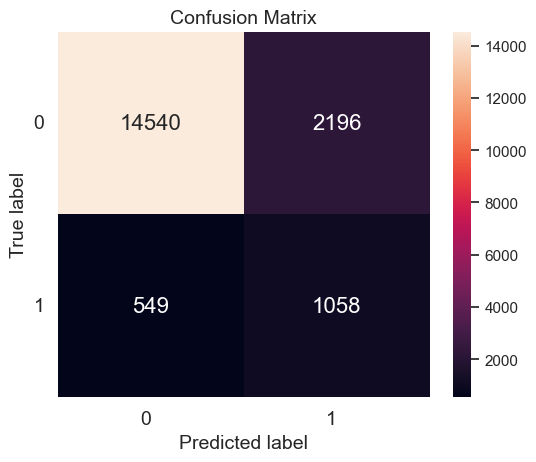

In [163]:
# Confusion matrix
pred_tuned = model.predict(X_test)
threshold = 0.5
y_pred_tuned = [0 if pred_tuned[i][0] < threshold else 1 for i in range(len(pred_tuned))]
confusion_mat(y_pred_tuned, y_test)

In [164]:
# Evaluation metrics
acc = accuracy_score(y_test, y_pred_tuned)
roc_auc = roc_auc_score(y_test, y_pred_tuned)
precision = precision_score(y_test, y_pred_tuned)
recall = recall_score(y_test, y_pred_tuned)
f1 = f1_score(y_test, y_pred_tuned)

print(pd.Series({"Accuracy": acc,
                 "ROC-AUC": roc_auc,
                 "Precision": precision,
                 "Recall": recall,
                 "F1-score": f1}).to_string())

Accuracy     0.850352
ROC-AUC      0.763578
Precision    0.325138
Recall       0.658370
F1-score     0.435301


### Saving and loading the model

In [165]:
# Saving the model
model.save('mcp.h5')

In [166]:
# Loading the model
model_tuned_loaded = load_model('mcp.h5')

# Model 2: DNN

In [175]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam

# Define the DNN Model
model = Sequential()

# Input layer and first hidden layer
model.add(Dense(128, input_dim=len(X_train.columns), activation='relu', kernel_regularizer=l2(0.001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))  # Dropout for regularization

# Second hidden layer
model.add(Dense(64, activation='relu', kernel_regularizer=l2(0.0001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))

# Third hidden layer
model.add(Dense(32, activation='relu', kernel_regularizer=l2(0.0001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))

# Fourth hidden layer
model.add(Dense(16, activation='relu', kernel_regularizer=l2(0.0001)))
model.add(BatchNormalization())
model.add(Dropout(0.4))

# Output layer for binary classification
model.add(Dense(1, activation='sigmoid'))

# Compile the model
optimizer = Adam(learning_rate=0.0001)  # Optimizer
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()


Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_18 (Dense)                │ (None, 128)            │        19,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_15 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 32)             │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_16 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 16)             │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_17 (Dropout)            │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 31,425 (122.75 KB)

 Trainable params: 30,945 (120.88 KB)

 Non-trainable params: 480 (1.88 KB)

In [176]:
# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, class_weight=class_weight_dict)

Epoch 1/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.5263 - loss: 1.0860 - val_accuracy: 0.7377 - val_loss: 0.6962
Epoch 2/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.6069 - loss: 0.8528 - val_accuracy: 0.7534 - val_loss: 0.6607
Epoch 3/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.6584 - loss: 0.7646 - val_accuracy: 0.7719 - val_loss: 0.6133
Epoch 4/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.6935 - loss: 0.7106 - val_accuracy: 0.7656 - val_loss: 0.6094
Epoch 5/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7095 - loss: 0.6825 - val_accuracy: 0.7822 - val_loss: 0.5745
Epoch 6/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7219 - loss: 0.6686 - val_accuracy: 0.7836 - val_loss: 0.5684
Epoch 7/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7348 - loss: 0.6367 - val_accuracy: 0.7880 - val_loss: 0.5513
Epoch 8/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7397 - loss: 0.6293 - 

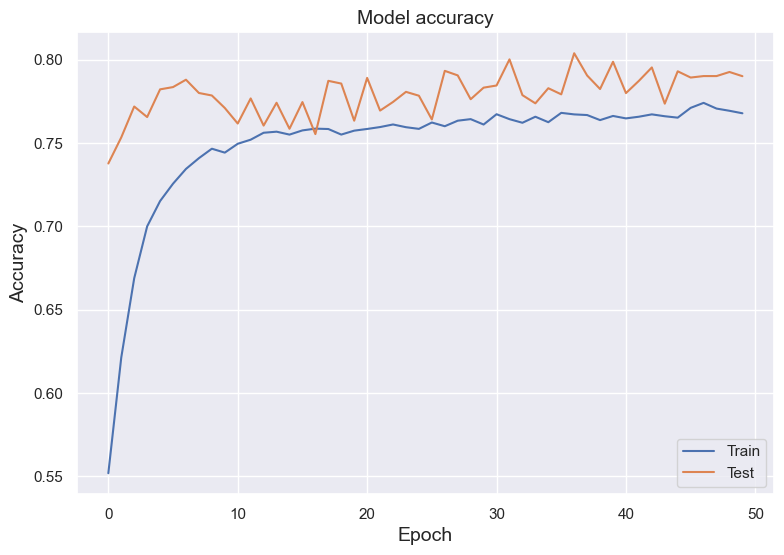

In [177]:
# Visualization of model accuracy
model_accuracy = pd.DataFrame()
model_accuracy['accuracy'] = history.history['accuracy']
model_accuracy['val_accuracy'] = history.history['val_accuracy']

plt.figure(figsize = (9, 6))
sns.lineplot(data = model_accuracy['accuracy'], label = 'Train')
sns.lineplot(data = model_accuracy['val_accuracy'], label = 'Test')
plt.title('Model accuracy', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend()
plt.show()

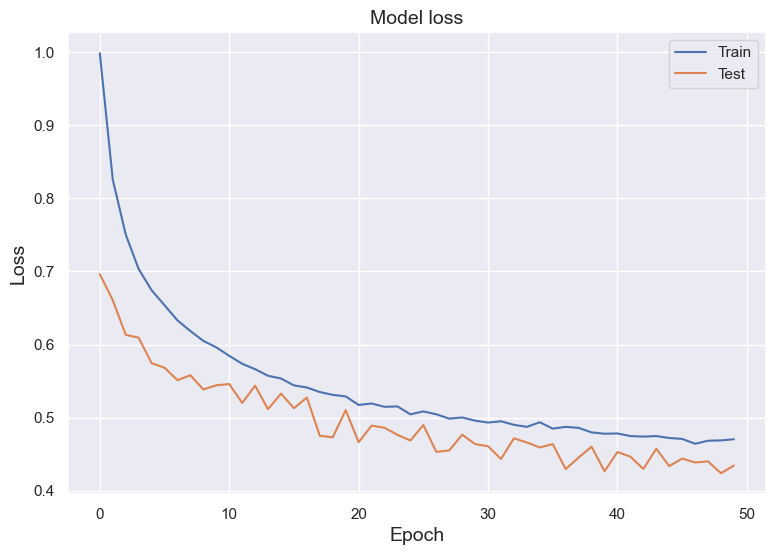

In [178]:
# Visualization of model loss
model_loss = pd.DataFrame()
model_loss['loss'] = history.history['loss']
model_loss['val_loss'] = history.history['val_loss']

plt.figure(figsize = (9, 6))
sns.lineplot(data = model_loss['loss'], label = 'Train')
sns.lineplot(data = model_loss['val_loss'], label = 'Test')
plt.title('Model loss', fontsize = 14)
plt.ylabel('Loss', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend()
plt.show()

In [179]:
# Prediction on test set
pred = model.predict(X_test)
threshold = 0.5
y_pred = [0 if pred[i][0] < threshold else 1 for i in range(len(pred))]

574/574 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


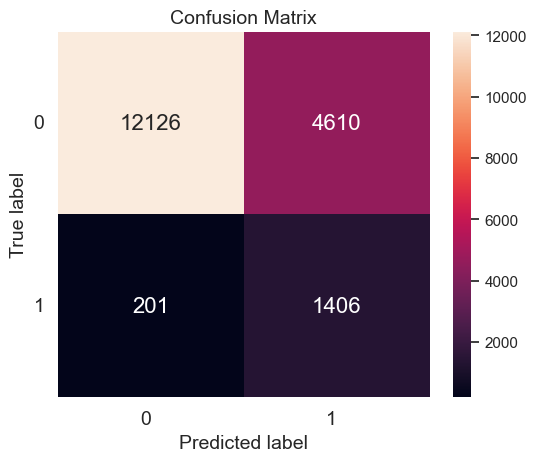

In [180]:
# Confusion matrix
confusion_mat(y_pred, y_test)

In [181]:
from sklearn.metrics import matthews_corrcoef

# Evaluation metrics
acc = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
mcc = matthews_corrcoef(y_test, y_pred)

# Printing the metrics
print(pd.Series({"Accuracy": acc,
                 "ROC-AUC": roc_auc,
                 "Precision": precision,
                 "Recall": recall,
                 "F1-score": f1,
                 "MCC": mcc}).to_string())


Accuracy     0.737720
ROC-AUC      0.799734
Precision    0.233710
Recall       0.874922
F1-score     0.368884
MCC          0.361008


In [182]:
import keras_tuner as kt
from tensorflow.keras.optimizers import Adam

def build_model(hp):
    model = Sequential()
    
    # Input layer and first hidden layer
    model.add(Dense(units=hp.Int('units_1', min_value=64, max_value=256, step=64),
                    input_dim=len(X_train.columns), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_1', min_value=0.0001, max_value=0.01, step=0.0001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_1', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Second hidden layer
    model.add(Dense(units=hp.Int('units_2', min_value=32, max_value=128, step=32), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_2', min_value=0.0001, max_value=0.01, step=0.0001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_2', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Third hidden layer
    model.add(Dense(units=hp.Int('units_3', min_value=16, max_value=64, step=16), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_3', min_value=0.0001, max_value=0.01, step=0.0001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_3', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Fourth hidden layer
    model.add(Dense(units=hp.Int('units_4', min_value=8, max_value=32, step=8), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_4', min_value=0.0001, max_value=0.01, step=0.0001))))
    model.add(BatchNormalization())
    model.add(Dropout(rate=hp.Float('dropout_4', min_value=0.2, max_value=0.5, step=0.1)))
    
    # Output layer
    model.add(Dense(1, activation='sigmoid'))
    
    # Compile the model
    model.compile(optimizer=Adam(learning_rate=hp.Float('lr', min_value=1e-5, max_value=1e-3, sampling='LOG')),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    
    return model


In [184]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,  # Number of different hyperparameter combinations to try
    executions_per_trial=1,  # Number of models to train for each hyperparameter set
    directory='hyperparameter_tuning',
    project_name='dnn_tuning'
)

# Search for the best hyperparameters
tuner.search(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, class_weight=class_weight_dict)


Trial 5 Complete [00h 04m 25s]
val_accuracy: 0.8631593585014343

Best val_accuracy So Far: 0.8835355043411255
Total elapsed time: 00h 22m 46s


In [185]:
# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print the best hyperparameters for each layer
print(f"""
Best Hyperparameters:
=====================
- Units in the first dense layer: {best_hps.get('units_1')}
- L2 regularization in the first dense layer: {best_hps.get('l2_1')}
- Dropout rate in the first dense layer: {best_hps.get('dropout_1')}

- Units in the second dense layer: {best_hps.get('units_2')}
- L2 regularization in the second dense layer: {best_hps.get('l2_2')}
- Dropout rate in the second dense layer: {best_hps.get('dropout_2')}

- Units in the third dense layer: {best_hps.get('units_3')}
- L2 regularization in the third dense layer: {best_hps.get('l2_3')}
- Dropout rate in the third dense layer: {best_hps.get('dropout_3')}

- Units in the fourth dense layer: {best_hps.get('units_4')}
- L2 regularization in the fourth dense layer: {best_hps.get('l2_4')}
- Dropout rate in the fourth dense layer: {best_hps.get('dropout_4')}

- Learning rate: {best_hps.get('lr')}
""")



Best Hyperparameters:
- Units in the first dense layer: 64
- L2 regularization in the first dense layer: 0.0083
- Dropout rate in the first dense layer: 0.4

- Units in the second dense layer: 64
- L2 regularization in the second dense layer: 0.0011
- Dropout rate in the second dense layer: 0.2

- Units in the third dense layer: 32
- L2 regularization in the third dense layer: 0.0057
- Dropout rate in the third dense layer: 0.2

- Units in the fourth dense layer: 24
- L2 regularization in the fourth dense layer: 0.0036
- Dropout rate in the fourth dense layer: 0.4

- Learning rate: 0.0009765032562976731



In [186]:
# Build the model with the best hyperparameters
model = tuner.hypermodel.build(best_hps)

# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, class_weight=class_weight_dict)



Epoch 1/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.6645 - loss: 1.5017 - val_accuracy: 0.8512 - val_loss: 0.6923
Epoch 2/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7590 - loss: 0.7161 - val_accuracy: 0.6739 - val_loss: 0.7282
Epoch 3/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7580 - loss: 0.5685 - val_accuracy: 0.8043 - val_loss: 0.4750
Epoch 4/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7556 - loss: 0.5410 - val_accuracy: 0.7485 - val_loss: 0.5361
Epoch 5/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7561 - loss: 0.5279 - val_accuracy: 0.8559 - val_loss: 0.3529
Epoch 6/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7570 - loss: 0.5165 - val_accuracy: 0.7404 - val_loss: 0.5263
Epoch 7/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7571 - loss: 0.5176 - val_accuracy: 0.7533 - val_loss: 0.5419
Epoch 8/50
1835/1835 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.7679 - loss: 0.5174 - 

574/574 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


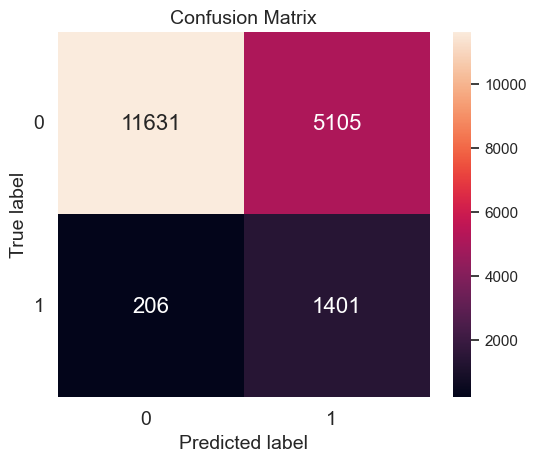

In [187]:
# Confusion matrix
pred_tuned = model.predict(X_test)
threshold = 0.5
y_pred_tuned = [0 if pred_tuned[i][0] < threshold else 1 for i in range(len(pred_tuned))]
confusion_mat(y_pred_tuned, y_test)

In [188]:
# Evaluation metrics
acc = accuracy_score(y_test, y_pred_tuned)
roc_auc = roc_auc_score(y_test, y_pred_tuned)
precision = precision_score(y_test, y_pred_tuned)
recall = recall_score(y_test, y_pred_tuned)
f1 = f1_score(y_test, y_pred_tuned)

print(pd.Series({"Accuracy": acc,
                 "ROC-AUC": roc_auc,
                 "Precision": precision,
                 "Recall": recall,
                 "F1-score": f1}).to_string())

Accuracy     0.710462
ROC-AUC      0.783390
Precision    0.215340
Recall       0.871811
F1-score     0.345372


In [189]:
# Saving the model
model.save('dnn.h5')

In [190]:
# Loading the model
model_tuned_loaded = load_model('dnn.h5')

# Model 3: GRU

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_6 (GRU)                     │ (None, 1, 128)         │       108,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ layer_normalization_9           │ (None, 1, 128)         │           256 │
│ (LayerNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 1, 128)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gru_7 (GRU)                     │ (None, 64)             │        37,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ layer_normalization_10          │ (None, 64)             │           128 │
│ (LayerNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ layer_normalization_11          │ (None, 64)             │           128 │
│ (LayerNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 150,273 (587.00 KB)

 Trainable params: 150,273 (587.00 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
6707/6707 ━━━━━━━━━━━━━━━━━━━━ 68s 9ms/step - accuracy: 0.6671 - loss: 2.1444 - val_accuracy: 0.7358 - val_loss: 1.3262 - learning_rate: 5.0000e-05
Epoch 2/100
6707/6707 ━━━━━━━━━━━━━━━━━━━━ 57s 8ms/step - accuracy: 0.7687 - loss: 1.0969 - val_accuracy: 0.7655 - val_loss: 0.9214 - learning_rate: 5.0000e-05
Epoch 3/100
6707/6707 ━━━━━━━━━━━━━━━━━━━━ 59s 9ms/step - accuracy: 0.7811 - loss: 0.7883 - val_accuracy: 0.6846 - val_loss: 0.8807 - learning_rate: 5.0000e-05
Epoch 4/100
6707/6707 ━━━━━━━━━━━━━━━━━━━━ 57s 9ms/step - accuracy: 0.7884 - loss: 0.6408 - val_accuracy: 0.7088 - val_loss: 0.7331 - learning_rate: 5.0000e-05
Epoch 5/100
6707/6707 ━━━━━━━━━━━━━━━━━━━━ 58s 9ms/step - accuracy: 0.7911 - loss: 0.5728 - val_accuracy: 0.7123 - val_loss: 0.6595 - learning_rate: 5.0000e-05
Epoch 6/100
6707/6707 ━━━━━━━━━━━━━━━━━━━━ 57s 9ms/step - accuracy: 0.7954 - loss: 0.5273 - val_accuracy: 0.7610 - val_loss: 0.5881 - learning_rate: 5.0000e-05
Epoch 7/100
6707/6707 ━━━━━━━━━━━━━━━━━━

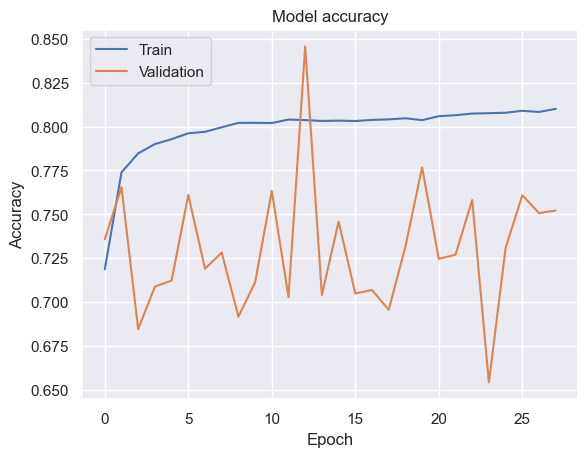

In [269]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, LayerNormalization, Dropout
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Nadam
from tensorflow.keras.constraints import max_norm
import numpy as np

# Flatten the 3D data to 2D
X_train_reshaped = X_train.reshape(X_train.shape[0], -1)

# Apply SMOTE to the flattened data
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_reshaped, y_train)

# Reshape back to 3D
X_train_resampled = X_train_resampled.reshape(X_train_resampled.shape[0], X_train.shape[1], X_train.shape[2])

# Define the GRU Model with adjusted architecture
model = Sequential()

# First GRU layer with more units
model.add(GRU(units=128, activation='tanh', input_shape=(X_train_resampled.shape[1], X_train_resampled.shape[2]), 
              return_sequences=True, kernel_regularizer=l2(0.005), recurrent_constraint=max_norm(3)))
model.add(LayerNormalization())
model.add(Dropout(0.4)) 

# Second GRU layer with increased units
model.add(GRU(units=64, activation='tanh', return_sequences=False, kernel_regularizer=l2(0.005), recurrent_constraint=max_norm(3)))
model.add(LayerNormalization())
model.add(Dropout(0.4))

# Fully connected layer with increased units
model.add(Dense(64, activation='relu', kernel_regularizer=l2(0.005)))
model.add(LayerNormalization())
model.add(Dropout(0.4))

# Output layer for binary classification
model.add(Dense(1, activation='sigmoid'))

# Compile the model with Nadam optimizer
optimizer = Nadam(learning_rate=0.00005)
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()

# Implement Early Stopping with adjusted patience and Learning Rate Reduction on Plateau
early_stopping = EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=7, min_lr=1e-7, verbose=1)

# Train the model
history = model.fit(X_train_resampled, y_train_resampled, epochs=100, batch_size=16, validation_split=0.2,
                    callbacks=[early_stopping, reduce_lr])

# Plotting accuracy
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


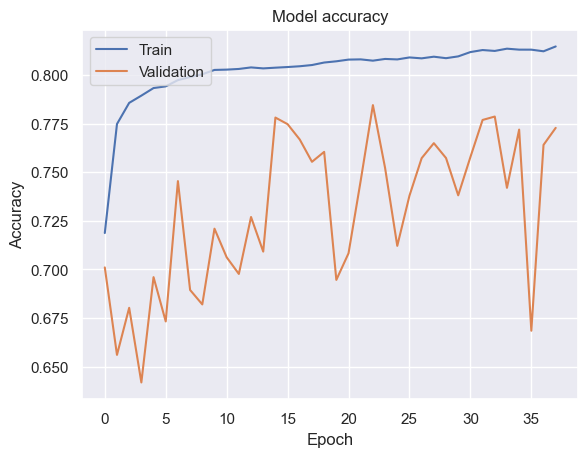

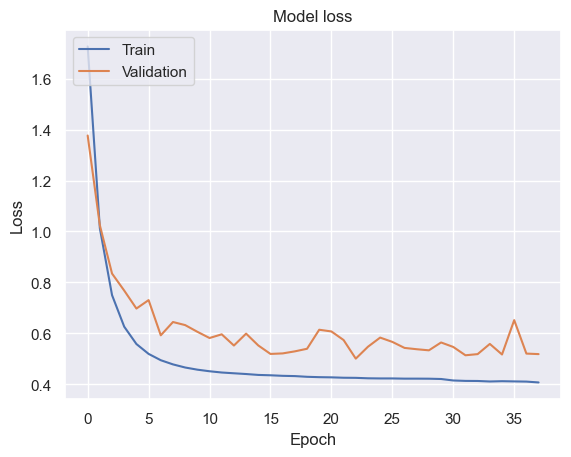

In [247]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


In [270]:
from sklearn.metrics import roc_auc_score

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {test_acc:.4f}")

# Predict probabilities for the test set
y_pred_prob = model.predict(X_test)

# Calculate ROC-AUC score
roc_auc = roc_auc_score(y_test, y_pred_prob)
print(f"ROC-AUC: {roc_auc:.4f}")


574/574 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.7248 - loss: 0.5356
Test Accuracy: 0.7281
574/574 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
ROC-AUC: 0.8798


574/574 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


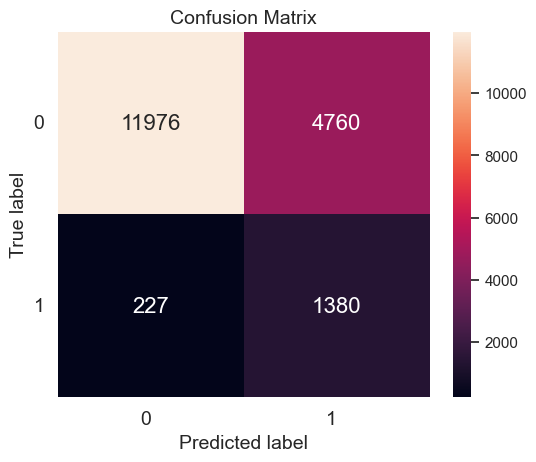

In [271]:
# Confusion matrix
pred_tuned = model.predict(X_test)
threshold = 0.5
y_pred_tuned = [0 if pred_tuned[i][0] < threshold else 1 for i in range(len(pred_tuned))]
confusion_mat(y_pred_tuned, y_test)

In [255]:
import keras_tuner as kt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, LayerNormalization, Dropout
from tensorflow.keras.optimizers import Nadam
from tensorflow.keras.regularizers import l2
from tensorflow.keras.constraints import max_norm

def build_model(hp):
    model = Sequential()
    
    # First GRU layer with tunable units, dropout, and regularization
    model.add(GRU(units=hp.Int('units_gru1', min_value=64, max_value=256, step=64),
                  activation='tanh', 
                  input_shape=(X_train_resampled.shape[1], X_train_resampled.shape[2]), 
                  return_sequences=True, 
                  kernel_regularizer=l2(hp.Float('l2_gru1', min_value=0.0001, max_value=0.01, step=0.0001)), 
                  recurrent_constraint=max_norm(3)))
    model.add(LayerNormalization())
    model.add(Dropout(rate=hp.Float('dropout_gru1', min_value=0.2, max_value=0.6, step=0.1)))
    
    # Second GRU layer with tunable units, dropout, and regularization
    model.add(GRU(units=hp.Int('units_gru2', min_value=32, max_value=128, step=32),
                  activation='tanh', 
                  return_sequences=False, 
                  kernel_regularizer=l2(hp.Float('l2_gru2', min_value=0.0001, max_value=0.01, step=0.0001)), 
                  recurrent_constraint=max_norm(3)))
    model.add(LayerNormalization())
    model.add(Dropout(rate=hp.Float('dropout_gru2', min_value=0.2, max_value=0.6, step=0.1)))

    # Fully connected layer with tunable units, dropout, and regularization
    model.add(Dense(units=hp.Int('units_dense', min_value=32, max_value=128, step=32), 
                    activation='relu', 
                    kernel_regularizer=l2(hp.Float('l2_dense', min_value=0.0001, max_value=0.01, step=0.0001))))
    model.add(LayerNormalization())
    model.add(Dropout(rate=hp.Float('dropout_dense', min_value=0.2, max_value=0.6, step=0.1)))

    # Output layer for binary classification
    model.add(Dense(1, activation='sigmoid'))

    # Compile the model with a tunable learning rate
    optimizer = Nadam(learning_rate=hp.Float('learning_rate', min_value=1e-5, max_value=1e-3, sampling='LOG'))
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    return model


In [258]:
tuner = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=50,
    factor=3,
    directory='hyperparameter_tuning',
    project_name='gru_tuning',
    overwrite=True  # This will overwrite the existing project with the same name
)

# Implement Early Stopping and Learning Rate Reduction on Plateau during tuning
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-7, verbose=1)

# Run the hyperparameter search
tuner.search(X_train_resampled, y_train_resampled, epochs=50, batch_size=16, validation_split=0.2,
             callbacks=[early_stopping, reduce_lr])


Trial 6 Complete [00h 02m 28s]
val_accuracy: 0.7627586126327515

Best val_accuracy So Far: 0.8702702522277832
Total elapsed time: 00h 13m 44s

Search: Running Trial #7

Value             |Best Value So Far |Hyperparameter
256               |192               |units_gru1
0.0095            |0.0062            |l2_gru1
0.2               |0.5               |dropout_gru1
64                |32                |units_gru2
0.0043            |0.0005            |l2_gru2
0.2               |0.4               |dropout_gru2
128               |96                |units_dense
0.0042            |0.0026            |l2_dense
0.5               |0.5               |dropout_dense
4.6339e-05        |0.00047321        |learning_rate
2                 |2                 |tuner/epochs
0                 |0                 |tuner/initial_epoch
3                 |3                 |tuner/bracket
0                 |0                 |tuner/round

Epoch 1/2
2420/6707 ━━━━━━━━━━━━━━━━━━━━ 51s 12ms/step - accuracy: 0.6551

KeyboardInterrupt: 

In [260]:
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
Best Hyperparameters:
=====================
- Units in the first GRU layer: {best_hps.get('units_gru1')}
- L2 regularization in the first GRU layer: {best_hps.get('l2_gru1')}
- Dropout rate in the first GRU layer: {best_hps.get('dropout_gru1')}
- Units in the second GRU layer: {best_hps.get('units_gru2')}
- L2 regularization in the second GRU layer: {best_hps.get('l2_gru2')}
- Dropout rate in the second GRU layer: {best_hps.get('dropout_gru2')}
- Units in the dense layer: {best_hps.get('units_dense')}
- L2 regularization in the dense layer: {best_hps.get('l2_dense')}
- Dropout rate in the dense layer: {best_hps.get('dropout_dense')}
- Learning rate: {best_hps.get('learning_rate')}
""")



Best Hyperparameters:
- Units in the first GRU layer: 192
- L2 regularization in the first GRU layer: 0.006200000000000001
- Dropout rate in the first GRU layer: 0.5
- Units in the second GRU layer: 32
- L2 regularization in the second GRU layer: 0.0005
- Dropout rate in the second GRU layer: 0.4
- Units in the dense layer: 96
- L2 regularization in the dense layer: 0.0026
- Dropout rate in the dense layer: 0.5
- Learning rate: 0.0004732107054805537



In [261]:
# Build the model with the best hyperparameters
model = tuner.hypermodel.build(best_hps)

# Train the final model
history = model.fit(X_train_resampled, y_train_resampled, epochs=100, batch_size=32, validation_split=0.2,
                    callbacks=[early_stopping, reduce_lr])


Epoch 1/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 39s 9ms/step - accuracy: 0.7175 - loss: 1.1517 - val_accuracy: 0.7298 - val_loss: 0.6578 - learning_rate: 4.7321e-04
Epoch 2/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 31s 9ms/step - accuracy: 0.7784 - loss: 0.5415 - val_accuracy: 0.6332 - val_loss: 0.7785 - learning_rate: 4.7321e-04
Epoch 3/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 30s 9ms/step - accuracy: 0.7846 - loss: 0.4914 - val_accuracy: 0.5659 - val_loss: 0.7596 - learning_rate: 4.7321e-04
Epoch 4/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 30s 9ms/step - accuracy: 0.7860 - loss: 0.4784 - val_accuracy: 0.7430 - val_loss: 0.5545 - learning_rate: 4.7321e-04
Epoch 5/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 30s 9ms/step - accuracy: 0.7858 - loss: 0.4744 - val_accuracy: 0.6458 - val_loss: 0.7322 - learning_rate: 4.7321e-04
Epoch 6/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 30s 9ms/step - accuracy: 0.7891 - loss: 0.4683 - val_accuracy: 0.7418 - val_loss: 0.5683 - learning_rate: 4.7321e-04
Epoch 7/100
3354/3354 ━━━━━━━━━━━━━━━━━━

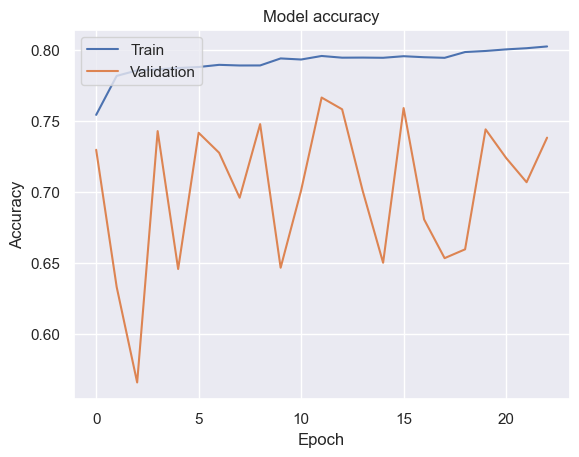

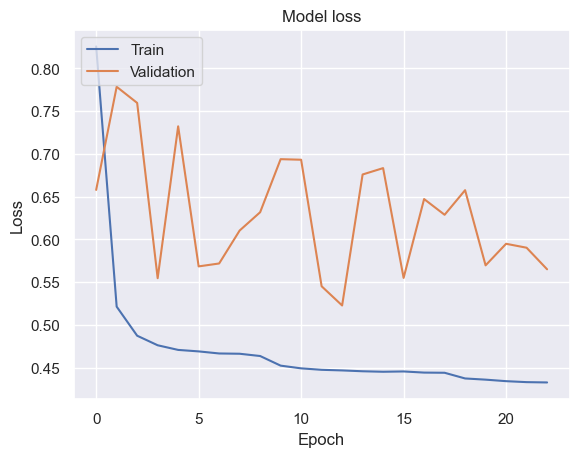

In [262]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


In [263]:
import numpy as np
from sklearn.metrics import roc_auc_score

# Ensure data types are correct for TensorFlow
X_test = np.array(X_test).astype(np.float32)
y_test = np.array(y_test).astype(np.int32)

X_train_resampled = np.array(X_train_resampled).astype(np.float32)
y_train_resampled = np.array(y_train_resampled).astype(np.int32)

# Build the model with the best hyperparameters
model = tuner.hypermodel.build(best_hps)

# Train the final model
history = model.fit(X_train_resampled, y_train_resampled, epochs=100, batch_size=32, validation_split=0.2,
                    callbacks=[early_stopping, reduce_lr])

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {test_acc:.4f}")

# Predict probabilities for the test set
y_pred_prob = model.predict(X_test)

# Calculate ROC-AUC score
roc_auc = roc_auc_score(y_test, y_pred_prob)
print(f"ROC-AUC: {roc_auc:.4f}")


Epoch 1/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 41s 10ms/step - accuracy: 0.7026 - loss: 1.1572 - val_accuracy: 0.6629 - val_loss: 0.7267 - learning_rate: 4.7321e-04
Epoch 2/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - accuracy: 0.7825 - loss: 0.5395 - val_accuracy: 0.8529 - val_loss: 0.4132 - learning_rate: 4.7321e-04
Epoch 3/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 35s 10ms/step - accuracy: 0.7852 - loss: 0.4933 - val_accuracy: 0.6630 - val_loss: 0.7014 - learning_rate: 4.7321e-04
Epoch 4/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 35s 10ms/step - accuracy: 0.7874 - loss: 0.4798 - val_accuracy: 0.7744 - val_loss: 0.5177 - learning_rate: 4.7321e-04
Epoch 5/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 33s 10ms/step - accuracy: 0.7877 - loss: 0.4710 - val_accuracy: 0.7149 - val_loss: 0.6046 - learning_rate: 4.7321e-04
Epoch 6/100
3354/3354 ━━━━━━━━━━━━━━━━━━━━ 30s 9ms/step - accuracy: 0.7875 - loss: 0.4710 - val_accuracy: 0.7459 - val_loss: 0.5619 - learning_rate: 4.7321e-04
Epoch 7/100
3350/3354 ━━━━━━━━━━━━━

574/574 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


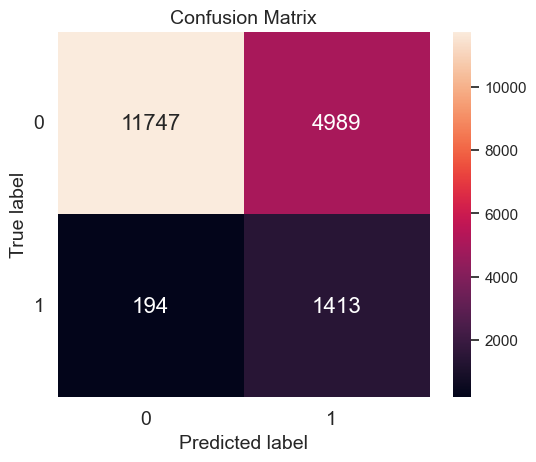

In [267]:
# Confusion matrix
pred_tuned = model.predict(X_test)
threshold = 0.5
y_pred_tuned = [0 if pred_tuned[i][0] < threshold else 1 for i in range(len(pred_tuned))]
confusion_mat(y_pred_tuned, y_test)

<a name = "Explainable-AI"></a>
# 6. Explainable AI

In [88]:
# Loading JavaScript library
shap.initjs()

# Sampling from test data predictors
X_test_sample = X_test.sample(50)

# Predicted values corresponding to the sample
pred_tuned_sample = np.array(pd.Series(data = pred_tuned.flatten(), index = X_test.index)[X_test_sample.index])
y_pred_tuned_sample = np.array(pd.Series(data = y_pred_tuned, index = X_test.index)[X_test_sample.index])

# Wrapper function
def wrap(X):
    return model_tuned.predict(X).flatten()

# Explainer
explainer = shap.KernelExplainer(wrap, X_test_sample)

# Computing SHAP values based on the sample
shap_values = explainer.shap_values(X_test_sample, nsamples = 500)

Provided model function fails when applied to the provided data set.


ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type float).

## Global interpretation

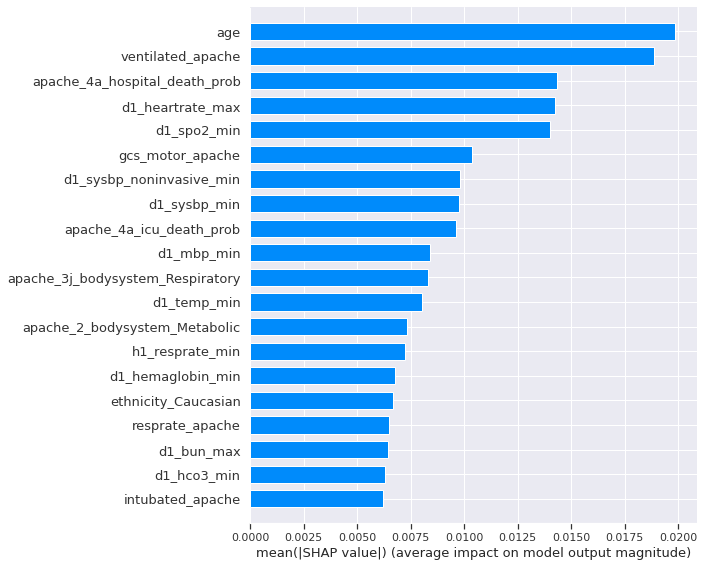

In [ ]:
# Summary plot
shap.summary_plot(shap_values = shap_values, features = X_test_sample, plot_type = 'bar')

## Local interpretation

### Explaining single prediction

In [ ]:
# Force plot
shap.initjs()
row = math.floor(3*len(X_test_sample)/4)
print(pd.Series({"Predicted value": pred_tuned_sample[row]}).to_string())
shap_values_row = explainer.shap_values(X_test_sample.iloc[row, :], nsamples = 500)
shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_values_row,
                features = X_test_sample.iloc[row, :],
                feature_names = X_test_sample.columns)

Predicted value    0.004913


Predicted value    0.004913


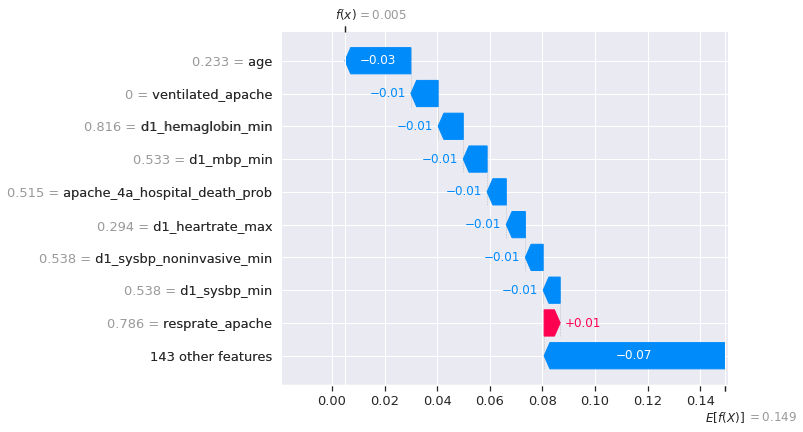

In [ ]:
# Waterfall plot
print(pd.Series({"Predicted value": pred_tuned_sample[row]}).to_string())
shap.waterfall_plot(shap.Explanation(values = shap_values_row,
                                     base_values = explainer.expected_value,
                                     data = X_test_sample.iloc[row, :],
                                     feature_names = X_test_sample.columns.tolist()))

Predicted value    0.004913


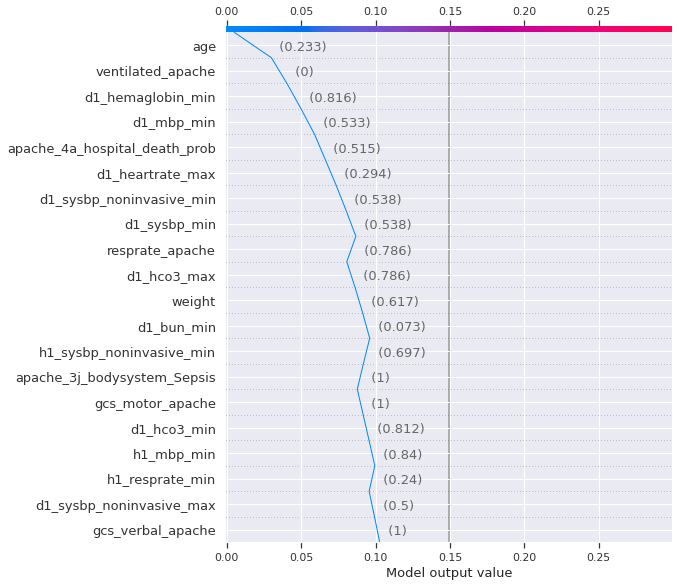

In [ ]:
# Decision plot
print(pd.Series({"Predicted value": pred_tuned_sample[row]}).to_string())
shap.decision_plot(base_value = explainer.expected_value,
                   shap_values = shap_values_row,
                   features = X_test_sample.iloc[row, :],
                   feature_names = X_test_sample.columns.tolist())

### Explaining multiple predictions

In [ ]:
# Force plot
shap.initjs()
shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_values,
                features = X_test_sample,
                feature_names = X_test_sample.columns)

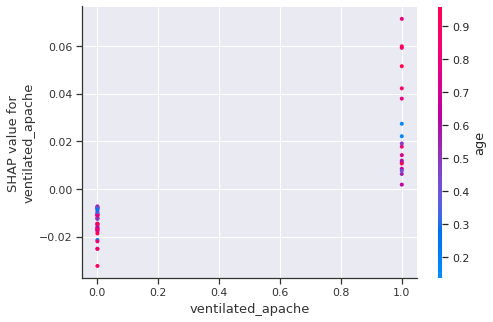

In [ ]:
# Dependence plot for ventilated_apache
shap.dependence_plot(ind = 'ventilated_apache', shap_values = shap_values, features = X_test_sample)

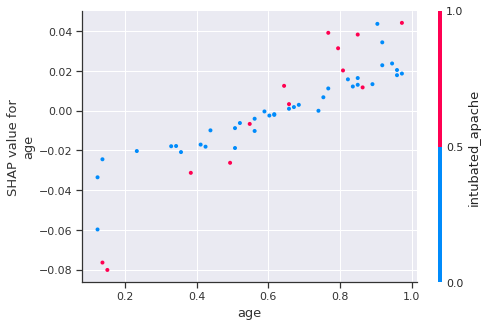

In [ ]:
# Dependence plot for age
shap.dependence_plot(ind = 'age', shap_values = shap_values, features = X_test_sample)

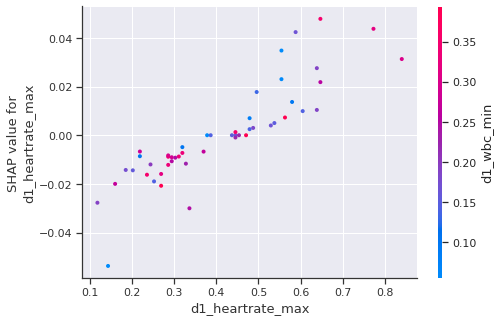

In [ ]:
# Dependence plot for age
shap.dependence_plot(ind = 'd1_heartrate_max', shap_values = shap_values, features = X_test_sample)

Predicted values
 
[0.03051385 0.9077343  0.5093913  0.01491031 0.00207022 0.17539304]
 


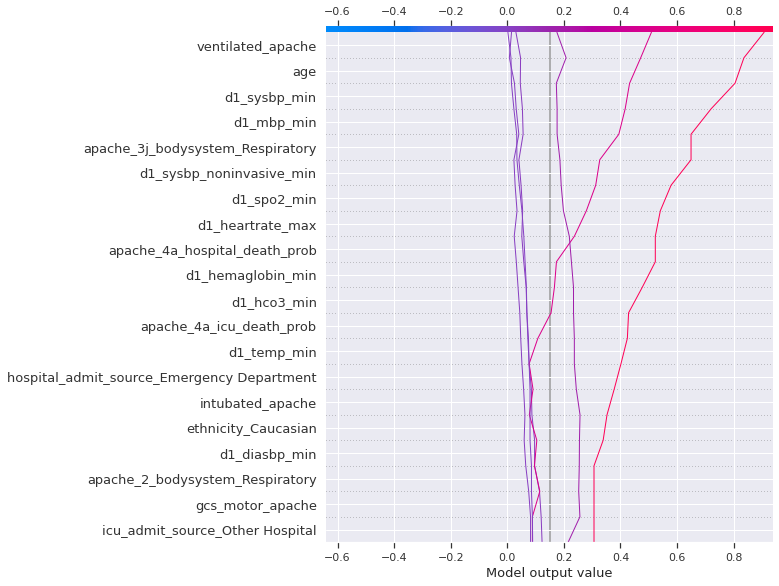

In [ ]:
# Decision plot
print("Predicted values")
print(" ")
rows = [i*math.floor(len(X_test_sample)/6) for i in range(6)]
print(np.array(pd.Series(pred_tuned_sample)[rows]))
print(" ")
shap.decision_plot(base_value = explainer.expected_value,
                   shap_values = shap_values[rows],
                   features = X_test_sample.iloc[rows, :],
                   feature_names = X_test_sample.columns.tolist())

<a name = "Acknowledgements"></a>
# Acknowledgements

- [Global Open Source Severity of Illness Score (GOSSIS) dataset](https://journals.lww.com/ccmjournal/Citation/2019/01001/33__THE_GLOBAL_OPEN_SOURCE_SEVERITY_OF_ILLNESS.36.aspx)
- [Introduction to the Keras Tuner](https://www.tensorflow.org/tutorials/keras/keras_tuner)

<a name = "References"></a>
# References

- [Freedman-Diaconis rule](https://en.wikipedia.org/wiki/Freedman%E2%80%93Diaconis_rule)
- [One-hot](https://en.wikipedia.org/wiki/One-hot)

In [ ]:
# Runtime and memory usage
stop = time.time()
process = psutil.Process(os.getpid())

In [ ]:
print(pd.Series({"Process runtime": "{:.2f} seconds".format(float(stop - start)),
                 "Process memory usage": "{:.2f} MB".format(float(process.memory_info()[0]/(1024*1024)))}).to_string())

Process runtime         2533.99 seconds
Process memory usage         2830.22 MB
